# NETFLIX_MOVIES_AND_TV_SHOWS_CLUSTERING

##### **Project Type**    - Clustering 
##### **Contribution**    - Individual
##### **Team Member 1**-  $\color{green}{\text{Puneet Suthar}}$
##### **Github Link **    - https://github.com/Puneet-Suthar/NETFLIX_MOVIES_AND_TV_SHOWS_CLUSTERING

# **Problem Statement**

This dataset consists of tv shows and movies available on Netflix as of 2019. The dataset is collected from Flixable which is a third-party Netflix search engine.

In 2018, they released an interesting report which shows that the number of TV shows on Netflix has nearly tripled since 2010. The streaming service’s number of movies has decreased by more than 2,000 titles since 2010, while its number of TV shows has nearly tripled. It will be interesting to explore what all other insights can be obtained from the same dataset.

Integrating this dataset with other external datasets such as IMDB ratings, rotten tomatoes can also provide many interesting findings.

## <b>In this  project, you are required to do </b>
1. Exploratory Data Analysis 

2. Understanding what type content is available in different countries

3. Is Netflix has increasingly focusing on TV rather than movies in recent years.
4. Clustering similar content by matching text-based features



# **Attribute Information**

1. show_id : Unique ID for every Movie / Tv Show

2. type : Identifier - A Movie or TV Show

3. title : Title of the Movie / Tv Show

4. director : Director of the Movie

5. cast : Actors involved in the movie / show

6. country : Country where the movie / show was produced

7. date_added : Date it was added on Netflix

8. release_year : Actual Releaseyear of the movie / show

9. rating : TV Rating of the movie / show

10. duration : Total Duration - in minutes or number of seasons

11. listed_in : Genere

12. description: The Summary description

# **Data Aquisition and General EDA**

## Importing Libraries

In [123]:
#Importing the libraries
import pandas as pd
import numpy as np

import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
          

In [124]:
# Importing various required libraries 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.cm as cm
%matplotlib inline

import datetime as dt

import warnings
warnings.filterwarnings("ignore")

import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
from plotly.offline import init_notebook_mode, iplot
import matplotlib.cm as cm

from collections import Counter

import nltk 
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import string 
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer
from wordcloud import WordCloud
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.cluster import KMeans , AgglomerativeClustering
from sklearn.metrics import silhouette_samples, silhouette_score

from gensim.models.ldamulticore import LdaMulticore
from gensim.models.coherencemodel import CoherenceModel


## Overview of Data

In [125]:
# loading the dataset 
df = pd.read_csv('NETFLIX MOVIES AND TV SHOWS CLUSTERING.csv', encoding= 'unicode_escape')

# Viewing the data of top 5 rows to take a glimps of the data
df.head(2)

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
0,s1,TV Show,3%,NaN,"JoÃ£o Miguel, Bianca Comparato, Michel Gomes, ...",Brazil,"August 14, 2020",2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...
1,s2,Movie,7:19,Jorge Michel Grau,"DemiÃ¡n Bichir, HÃ©ctor Bonilla, Oscar Serrano...",Mexico,"December 23, 2016",2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...


## Basic info

In [126]:
# Basic info
print(df.info())

df.describe(include = 'all')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7787 entries, 0 to 7786
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   show_id       7787 non-null   object
 1   type          7787 non-null   object
 2   title         7787 non-null   object
 3   director      5398 non-null   object
 4   cast          7069 non-null   object
 5   country       7280 non-null   object
 6   date_added    7777 non-null   object
 7   release_year  7787 non-null   int64 
 8   rating        7780 non-null   object
 9   duration      7787 non-null   object
 10  listed_in     7787 non-null   object
 11  description   7787 non-null   object
dtypes: int64(1), object(11)
memory usage: 730.2+ KB
None


,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
count,7787,7787,7787,5398,7069,7280,7777,7787.000000,7780,7787,7787,7787
unique,7787,2,7787,4049,6831,681,1565,NaN,14,216,492,7769
top,s1,Movie,3%,"RaÃºl Campos, Jan Suter",David Attenborough,United States,"January 1, 2020",NaN,TV-MA,1 Season,Documentaries,Multiple women report their husbands as missin...
freq,1,5377,1,18,18,2555,118,NaN,2863,1608,334,3
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2013.932580,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.757395,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1925.000000,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2013.000000,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017.000000,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2018.000000,NaN,NaN,NaN,NaN


In [127]:
# checking for null values
df.isna().sum()

show_id            0
type               0
title              0
director        2389
cast             718
country          507
date_added        10
release_year       0
rating             7
duration           0
listed_in          0
description        0
dtype: int64

In [128]:
# Checking null values in percentage
df.isnull().sum()/df.shape[0]*100

show_id          0.000000
type             0.000000
title            0.000000
director        30.679337
cast             9.220496
country          6.510851
date_added       0.128419
release_year     0.000000
rating           0.089893
duration         0.000000
listed_in        0.000000
description      0.000000
dtype: float64

**NULL VALUE TREATMENT**

1. RATING & COUNTRY - As rating column has 0.08% null values , so replacing nulls with mose frequent TV-MA rating and doing same thing with country column

2. CAST - cast column has too many different values and more than 9% are missing.

3. DATE - there are few missing values for date column. so, lets drop missing value rows. in feature engineering section.

4. DIRECTOR - Director column has more then 30% null values so replacing null with unknown in feature engineering section

In [129]:
# Checking Duplicate Values
value=len(df[df.duplicated()])
print("The number of duplicate values in the data set is = ",value)

#print the unique value
print("The number of unique values in the data set are :-")
df.nunique()

The number of duplicate values in the data set is =  0
The number of unique values in the data set are :-


show_id         7787
type               2
title           7787
director        4049
cast            6831
country          681
date_added      1565
release_year      73
rating            14
duration         216
listed_in        492
description     7769
dtype: int64

In [130]:
#print the  value of categorical data
cat_col = ['type', 'director', 'cast', 'country',
       'release_year', 'rating']
for col in cat_col:
    print(col,':-')
    print(df[col].value_counts())
    print('--------------------------------------------')

type :-
Movie      5377
TV Show    2410
Name: type, dtype: int64
--------------------------------------------
director :-
RaÃºl Campos, Jan Suter    18
Marcus Raboy               16
Jay Karas                  14
Cathy Garcia-Molina        13
Youssef Chahine            12
                           ..
Vibhu Virender Puri         1
Lucien Jean-Baptiste        1
Jason Krawczyk              1
Quinn Lasher                1
Sam Dunn                    1
Name: director, Length: 4049, dtype: int64
--------------------------------------------
cast :-
David Attenborough                                                                                                                                                            18
Samuel West                                                                                                                                                                   10
Jeff Dunham                                                                                       

# **Feature Engineeing & Data Cleaning** 

In [131]:
# Handeling null values of data frame

df['rating'].replace(np.nan, 'TV-MA',inplace  = True)
df['country'].fillna(value=df['country'].mode()[0],inplace=True)
df['cast'].replace(np.nan, 'No cast',inplace  = True)
df['director'].replace(np.nan, 'Unknown',inplace  = True)

In [132]:
# Dropping row not having release date
df = df[df['date_added'].notna()]
df.shape

(7777, 12)

In [133]:
# Adding new features from date column (it will be helpfull in eda section)

df["date_added"] = pd.to_datetime(df['date_added'])
df['year_added'] = df['date_added'].dt.year
df['month_added'] = df['date_added'].dt.month
df['day_added'] = df['date_added'].dt.day

In [134]:
# Converting duration column from string to int

df['duration']=df['duration'].str.replace('Season','')
df['duration']=df['duration'].str.replace('s','')
df['duration']=df['duration'].str.replace('min','')

df['duration']=df['duration'].astype(str).astype(int)
df['duration']

0         4
1        93
2        78
3        80
4       123
       ... 
7782     99
7783    111
7784     44
7785      1
7786     90
Name: duration, Length: 7777, dtype: int32

In [135]:
# Convert countries from string to list

df['country'] = df['country'].apply(lambda x : x.replace(', ',','))
df['country'] = df['country'].apply(lambda x : x.split(','))
df['country'] = df['country'].apply(lambda x :[country.strip() for country in x])
df['country'] = df['country'].apply(lambda x : [country.replace(" ", "_") for country in x])
df['country_count'] = df['country'].apply(lambda x : len(x))

In [136]:
print('No. of movies having courtry count more than 1 = {}'.format(df[df['country_count'] >1].title.count()))
print('Max country count = {}'.format(df['country_count'].max()))

No. of movies having courtry count more than 1 = 1153
Max country count = 12


In [137]:
# Converting listed_in column from string to list of countrys

df['listed_in'] = df['listed_in'].apply(lambda x : x.split(','))
df['listed_in'] = df['listed_in'].apply(lambda x : [country.strip() for country in x])
df['listed_in'] = df['listed_in'].apply(lambda x : [listed_in.replace(" ", "_") for listed_in in x])

# Converting cast column from string to list of cast

df['cast'] = df['cast'].apply(lambda x : x.split(','))
df['cast'] = df['cast'].apply(lambda x : [cast.strip() for cast in x])
df['cast'] = df['cast'].apply(lambda x : [cast.replace(" ", "_") for cast in x])

# Converting director column from string to list of cast

df['director'] = df['director'].apply(lambda x : x.split(','))
df['director'] = df['director'].apply(lambda x : [director.strip() for director in x])
df['director'] = df['director'].apply(lambda x : [director.replace(" ", "_") for director in x])

In [138]:
# Creating Feature on the basis of count

df['number_of_directors'] = df['director'] .apply(lambda x : len(x))
df['number_of_casts']     = df['cast']     .apply(lambda x : len(x))
df['number_of_countries'] = df['country']  .apply(lambda x : len(x))
df['number_of_genres']    = df['listed_in'].apply(lambda x : len(x))

In [139]:
df.head(1)

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description,year_added,month_added,day_added,country_count,number_of_directors,number_of_casts,number_of_countries,number_of_genres
0,s1,TV Show,3%,[Unknown],"[JoÃ£o_Miguel, Bianca_Comparato, Michel_Gomes,...",[Brazil],2020-08-14,2020,TV-MA,4,"[International_TV_Shows, TV_Dramas, TV_Sci-Fi_...",In a future where the elite inhabit an island ...,2020,8,14,1,1,11,1,3


In [140]:
df[df['country_count']>2].head(2)

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description,year_added,month_added,day_added,country_count,number_of_directors,number_of_casts,number_of_countries,number_of_genres
17,s18,Movie,22-Jul,[Paul_Greengrass],"[Anders_Danielsen_Lie, Jon_Ãigarden, Jonas_St...","[Norway, Iceland, United_States]",2018-10-10,2018,R,144,"[Dramas, Thrillers]","After devastating terror attacks in Norway, a ...",2018,10,10,3,1,7,3,2
68,s69,Movie,14 Blades,[Daniel_Lee],"[Donnie_Yen, Zhao_Wei, Wu_Chun, Law_Kar-Ying, ...","[Hong_Kong, China, Singapore]",2019-04-03,2010,R,113,"[Action_&_Adventure, International_Movies]","In the age of the Ming Dynasty, Quinglong is t...",2019,4,3,3,1,12,3,2


In [141]:
# reindexing 
df = df.reset_index()

In [143]:
# Checking null values in percentage
df.isnull().sum()/df.shape[0]*100

index                  0.0
show_id                0.0
type                   0.0
title                  0.0
director               0.0
cast                   0.0
country                0.0
date_added             0.0
release_year           0.0
rating                 0.0
duration               0.0
listed_in              0.0
description            0.0
year_added             0.0
month_added            0.0
day_added              0.0
country_count          0.0
number_of_directors    0.0
number_of_casts        0.0
number_of_countries    0.0
number_of_genres       0.0
dtype: float64

# **EDA**

In [144]:
df.head(2)

,index,show_id,type,title,director,cast,country,date_added,release_year,rating,...,listed_in,description,year_added,month_added,day_added,country_count,number_of_directors,number_of_casts,number_of_countries,number_of_genres
0,0,s1,TV Show,3%,[Unknown],"[JoÃ£o_Miguel, Bianca_Comparato, Michel_Gomes,...",[Brazil],2020-08-14,2020,TV-MA,...,"[International_TV_Shows, TV_Dramas, TV_Sci-Fi_...",In a future where the elite inhabit an island ...,2020,8,14,1,1,11,1,3
1,1,s2,Movie,7:19,[Jorge_Michel_Grau],"[DemiÃ¡n_Bichir, HÃ©ctor_Bonilla, Oscar_Serran...",[Mexico],2016-12-23,2016,TV-MA,...,"[Dramas, International_Movies]",After a devastating earthquake hits Mexico Cit...,2016,12,23,1,1,6,1,2


## Column - type

In [145]:
# ploting for pie chart on type feature (using plotly)

x = df['type'].value_counts().reset_index()

colors=['DodgerBlue','PaleTurquoise']

fig = px.pie(x,title='Type of Netflix Content',values='type',names='index',color_discrete_sequence=px.colors.sequential.RdBu)

fig.update_traces(textposition='inside', textinfo='percent+label', textfont_size=20,
              marker=dict(colors=colors, line=dict(color='#000000', width=2)))


**Observations :-**
1. The majority of content on Netflix is made up of movies, while TV shows make up a smaller portion. Specifically, there are approximately 70% movies and 30% TV shows on Netflix.

## Column - director

In [146]:
# function to make a count dict form a columm of lists\

def count_dict_maker(df,col):
    data_count_dict = {}
    data_set = set()

    for data_list in df[col]:
        for data in data_list:
            data_set.add(data)

    data_unique_list = list(data_set)

    for data in data_unique_list:
        data_count_dict[data] = 0


    for data_list in df[col]:
        for data in data_list:
            data_count_dict[data] = data_count_dict[data] + 1
    
    return data_count_dict


(4478, 1)


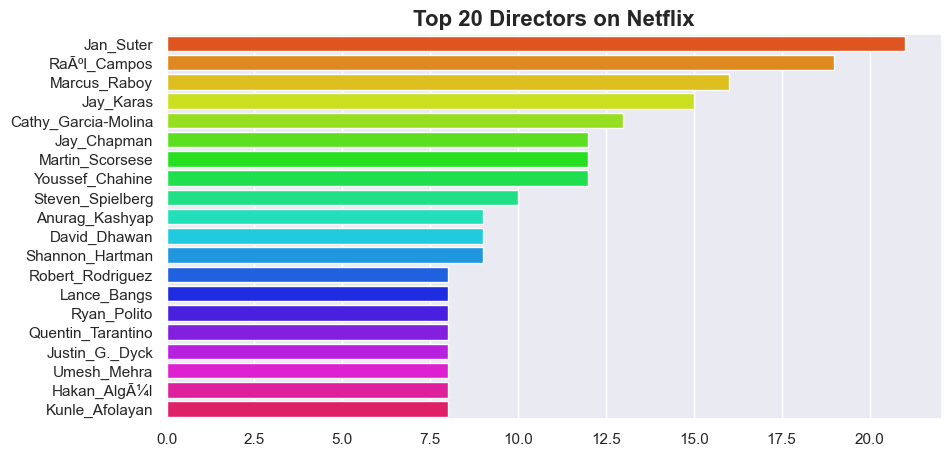

In [147]:
# Top 20 Directors in netflix
# Create a dictionary to count genre
director_count_dict = count_dict_maker(df,'director')
del director_count_dict['Unknown']

# Top Genre in movies
df_director = pd.DataFrame.from_dict(director_count_dict,columns=['count'], orient='index')
df_director.sort_values('count', ascending= False, inplace=True)
print(df_director.shape)
df_director = df_director[:20]

# Plot the bar plot
plt.figure(figsize=(10,5))
#sns.countplot(x='rating',hue='type',data=df,palette="CMRmap")
sns.barplot(y = df_director.index,
            x = df_director['count'].values,palette="hsv")
plt.title("Top 20 Directors on Netflix",size='16',fontweight="bold")
plt.show()

## Column - cast

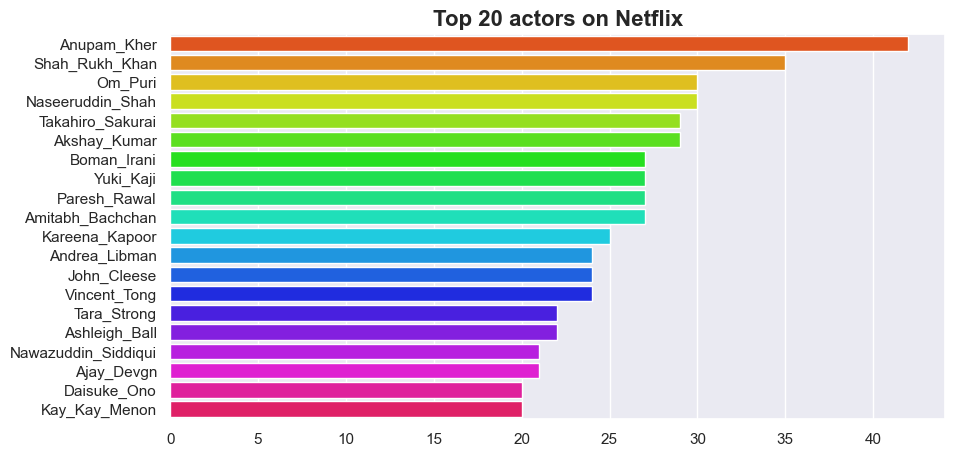

In [148]:
# Top 20 actors netflix
# Create a dictionary to count cast

cast_count_dict = count_dict_maker(df,'cast')
del cast_count_dict['No_cast']

# Top Genre in movies
df_cast = pd.DataFrame.from_dict(cast_count_dict,columns=['count'], orient='index')
df_cast.sort_values('count', ascending= False, inplace=True)
df_cast = df_cast[:20]

# Plot the bar plot
plt.figure(figsize=(10,5))
#sns.countplot(x='rating',hue='type',data=df,palette="CMRmap")
sns.barplot(y = df_cast.index,
            x = df_cast['count'].values,palette="hsv")
plt.title("Top 20 actors on Netflix",size='16',fontweight="bold")
plt.show()

## Column- Country

In [149]:
# Create a dictionary to count countries

country_count_dict = count_dict_maker(df,'country')
#del country_count_dict['']

# Distribution of content in countries

fig = px.pie(country_count_dict.keys(), values=country_count_dict.values(), names=country_count_dict.keys(), 
                color_discrete_sequence=px.colors.sequential.Plasma_r, width=1300, height=500)

fig.update_traces(textposition='inside', textinfo='percent+label',marker = dict(line = dict(color = 'darkred', width = 1)))
fig.update_layout(
    title={
        'text': "Distribution of content in countries"})
fig.show()


In [151]:
exploded_df = df.explode('country')

gb_country = exploded_df.groupby(['country','type'])['title'].count()
gb_country = pd.DataFrame(gb_country)

display(gb_country.sort_values('country',ascending=False))


title
country      type          
Zimbabwe     Movie        3
West_Germany TV Show      2
             Movie        3
Vietnam      Movie        5
Venezuela    Movie        3
...                     ...
Angola       Movie        1
Algeria      Movie        2
Albania      Movie        1
Afghanistan  Movie        1
             Movie        4

[176 rows x 1 columns]

In [178]:
# count of content by countries
grouped = exploded_df.groupby(['country', 'type'])['title'].count().reset_index()
country_totals = grouped.groupby('country').sum()
sorted_totals = country_totals.sort_values('title', ascending=False)
top_10_countries = sorted_totals.head(10).index

fig = px.bar(grouped[grouped['country'].isin(top_10_countries)], x='country', y='title', color='type', barmode='group',
             title='Number of content by top 10 countries and their type')

fig.show()


In [185]:
import plotly.express as px

grouped = exploded_df.groupby(['country', 'type', 'rating'])['title'].count().reset_index()
country_totals = grouped.groupby('country').sum()
sorted_totals = country_totals.sort_values('title', ascending=False)
top_10_countries = sorted_totals.head(10).index

fig = px.bar(grouped[grouped['country'].isin(top_10_countries)], x='country', y='title', color='rating', barmode='group',height=600,
             title='Number of content by countries and their rating')

fig.show()


## Column - date_added and release year

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


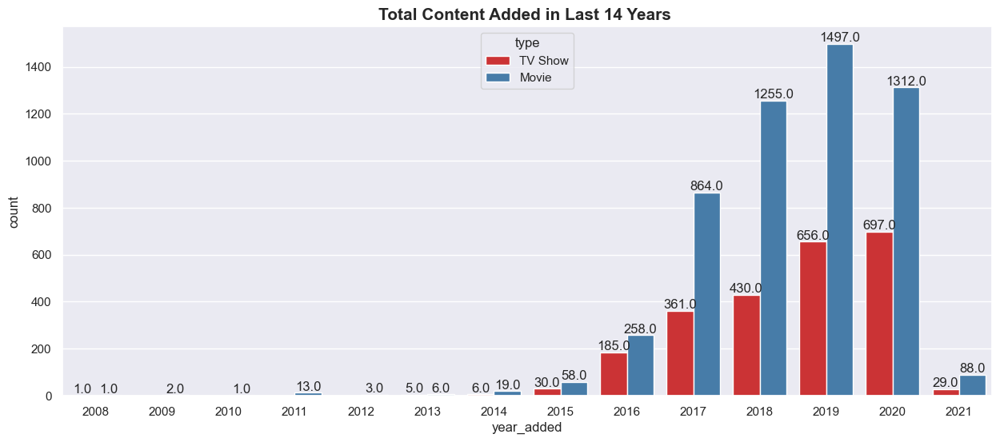

In [154]:
# Total Content Added in last 14 years
sns.set(rc={'figure.figsize':(15,6)})
ax = sns.countplot(x='year_added',hue = 'type',data=df,palette="Set1")

# loop through each bar in the plot and add the count as label
for patch in ax.patches:
    height = patch.get_height()
    ax.text(patch.get_x() + patch.get_width()/2., height,
            height, ha="center", va="bottom")

plt.title('Total Content Added in Last 14 Years ',size='15',fontweight="bold")    
plt.show()

The growth of movies on Netflix far surpasses the growth of TV shows.

A significant increase in the number of both movies and TV shows on the Netflix platform can be observed starting from 2015.

2019 and 2020 saw the highest addition of movies and TV shows.

However, there was a noticeable drop in the number of movies and TV shows added in 2021.

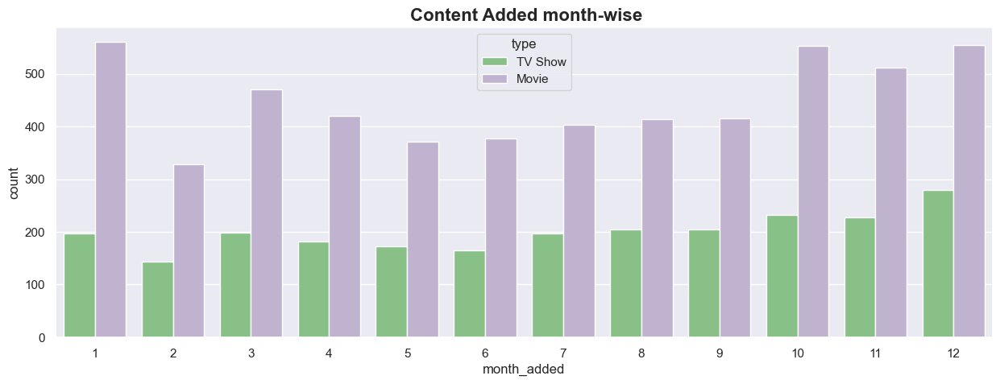

In [155]:
# Content Added month-wise
sns.set(rc={'figure.figsize':(15,5)})
sns.countplot(x='month_added',hue = 'type', data=df,palette="Accent")

plt.title(' Content Added month-wise',size='16',fontweight="bold")    
plt.show()

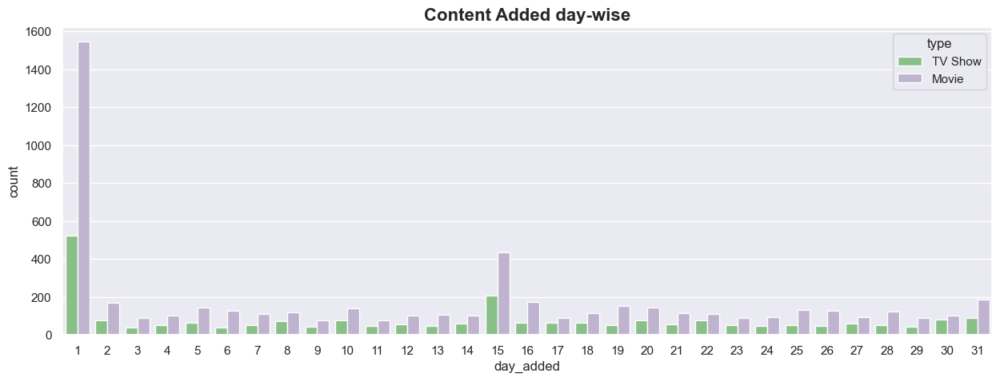

In [156]:
# Content Added day-wise
sns.set(rc={'figure.figsize':(15,5)})
sns.countplot(x='day_added',hue = 'type', data=df,palette="Accent")

plt.title('Content Added day-wise',size='16',fontweight="bold")    
plt.show()

 **Most of the content gets uploaded in the beginning and the middle of the month.**

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

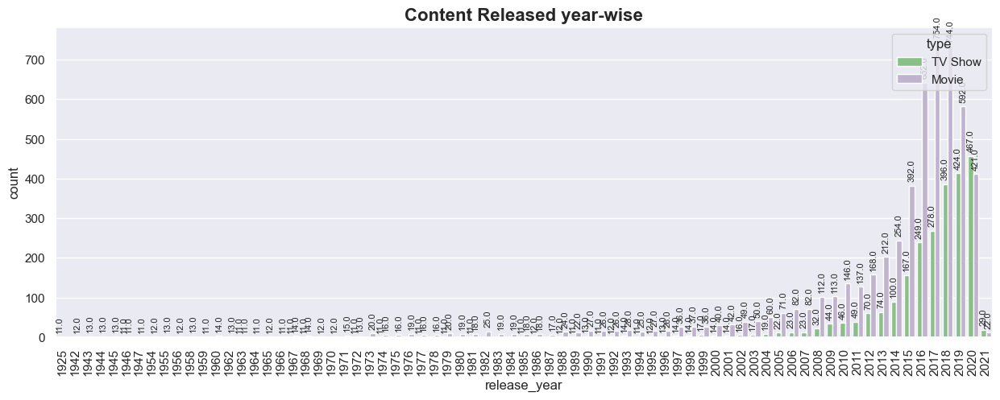

In [157]:
# Content Released year-wise
sns.set(rc={'figure.figsize':(15,5)})
ax = sns.countplot(x='release_year',hue = 'type', data=df,palette="Accent")
plt.xticks(rotation=90)

# loop through each bar in the plot and add the count as label
for patch in ax.patches:
    height = patch.get_height() + 10
    ax.text(patch.get_x() + patch.get_width()/2., height,
            height, ha="center", va="bottom", rotation = 90, fontsize = 8)


plt.title('Content Released year-wise',size='16',fontweight="bold")    
plt.show()

## column - Rating

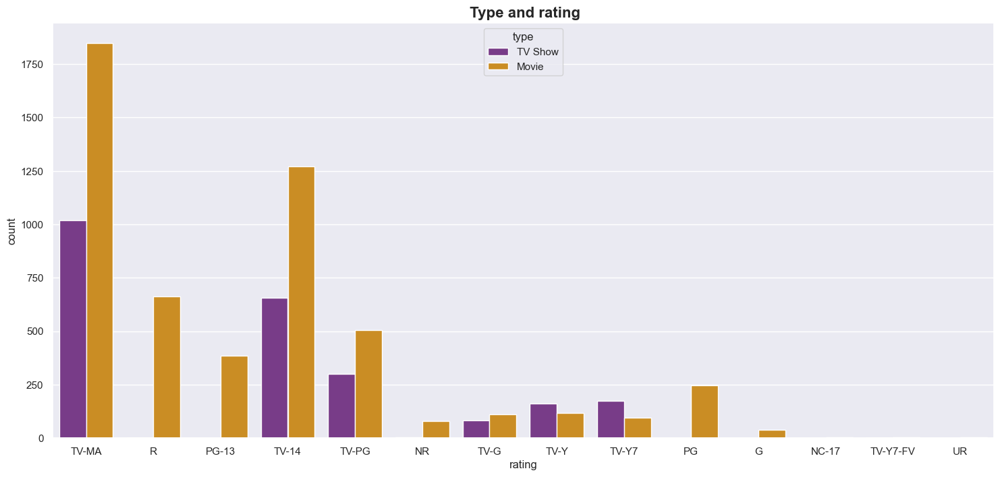

In [158]:
# Rating
plt.figure(figsize=(18,8))
sns.countplot(x='rating',hue='type',data=df,palette="CMRmap")
plt.title(' Type and rating',size='16',fontweight="bold")
plt.show()

As we can see the distribution is not correct, becz some movies are rated in tv rating and vice versa. so need be fixed

In [159]:
df['rating'][(df['rating'] == 'TV-MA') & (df['type'] == 'Movie')] = 'R'
df['rating'][(df['rating'] == 'TV-14') & (df['type'] == 'Movie')] = 'PG-13'
df['rating'][(df['rating'] == 'TV-PG') & (df['type'] == 'Movie')] = 'Soft PG-13'
df['rating'][(df['rating'] == 'TV-G' ) & (df['type'] == 'Movie')] = 'G'
df['rating'][(df['rating'] == 'TV-Y' ) & (df['type'] == 'Movie')] = 'G'
df['rating'][(df['rating'] == 'TV-Y7') & (df['type'] == 'Movie')] = 'G'

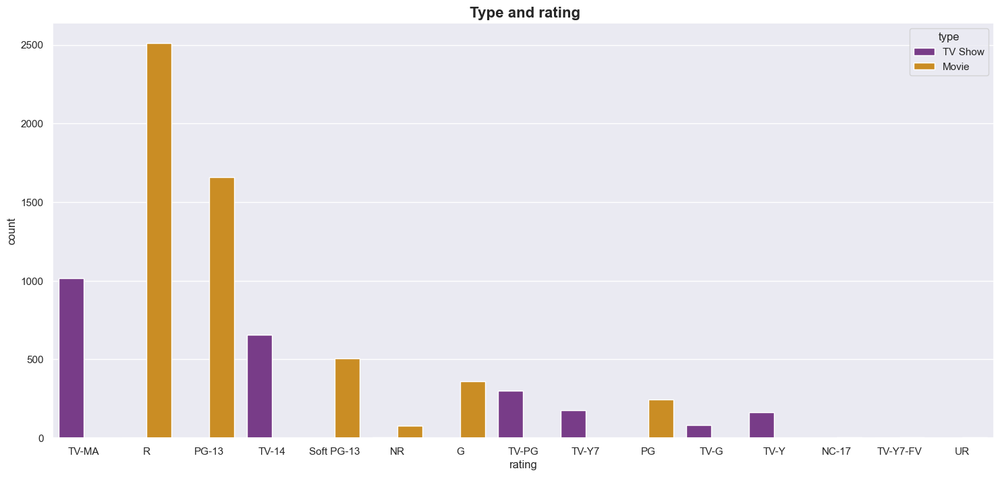

In [160]:
# Rating
plt.figure(figsize=(18,8))
sns.countplot(x='rating',hue='type',data=df,palette="CMRmap")
plt.title(' Type and rating',size='16',fontweight="bold")
plt.show()

Majority of countries have highest content as mature content, India have TV-14 as highest and then mature content

## Column - Duration

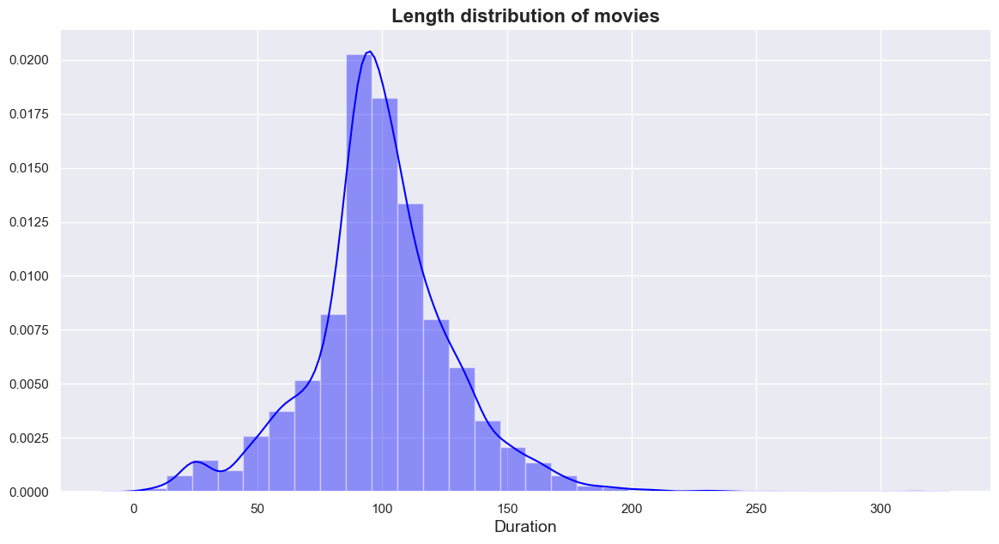

In [35]:
# Length distribution of movies
movie_df = df[df['type']=='Movie']

plt.figure(figsize=(14, 7))

sns.distplot(movie_df['duration'], bins=30,color='Blue').set(ylabel=None)

plt.title('Length distribution of movies', fontsize=16,fontweight="bold")
plt.xlabel('Duration', fontsize=14)
plt.show()

<AxesSubplot:xlabel='duration', ylabel='count'>

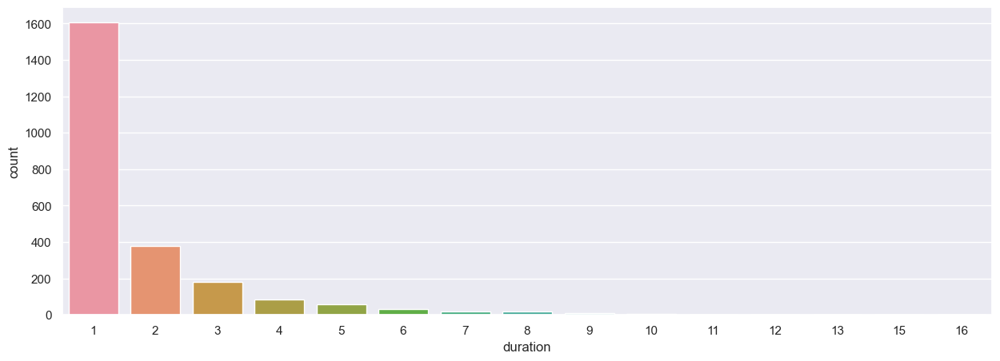

In [36]:
# Season-wise distribution of tv shows
tv_df = df[df['type']=='TV Show']

# Plot the bar plot
sns.countplot(x='duration', data=tv_df)

In [37]:
long_shows = tv_df[tv_df['duration']>9]
long_shows_df = long_shows[['title','duration']]
long_shows_df.sort_values(by=['duration'],ascending=False)

,title,duration
2534,Grey's Anatomy,16
4430,NCIS,15
5903,Supernatural,15
1469,COMEDIANS of the world,13
1535,Criminal Minds,12
7159,Trailer Park Boys,12
1298,Cheers,11
2673,Heartland,11
1575,Dad's Army,10
1595,Danger Mouse: Classic Collection,10


## Column - listed_in

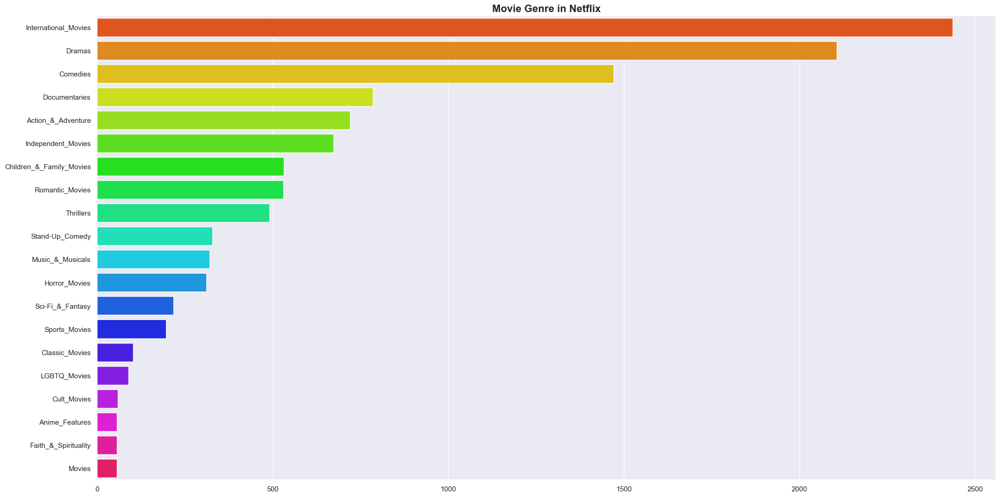

In [38]:
# Genre EDA for Movies

# Create a dictionary to count genre
genre_count_dict = count_dict_maker(df[df['type'] == 'Movie'],'listed_in')

# Top Genre in movies
df_genre = pd.DataFrame.from_dict(genre_count_dict,columns=['count'], orient='index')
df_genre.sort_values('count', ascending= False, inplace=True)

# Plot the bar plot
plt.figure(figsize=(25,13))
#sns.countplot(x='rating',hue='type',data=df,palette="CMRmap")
sns.barplot(y = df_genre.index,
            x = df_genre['count'].values,palette="hsv")
plt.title("Movie Genre in Netflix",size='16',fontweight="bold")
plt.show()

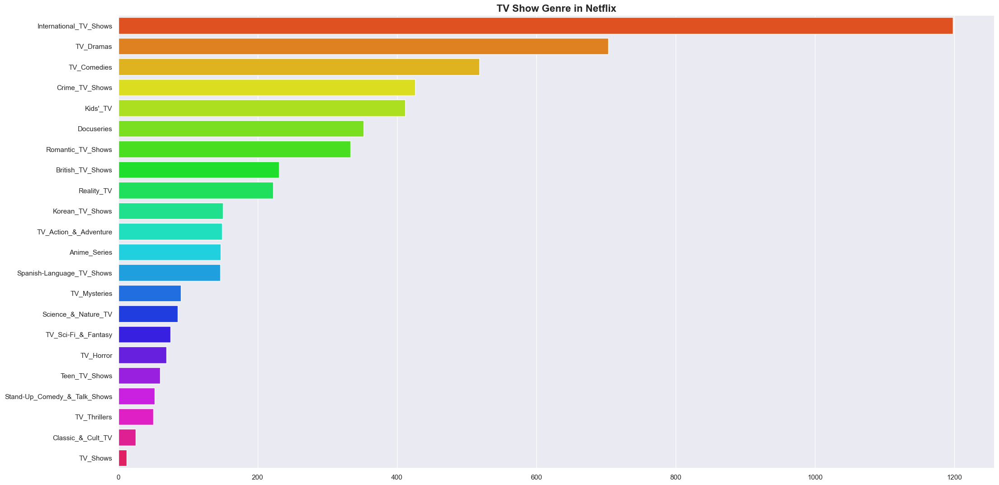

In [39]:
# Genre EDA for TV Show

# Create a dictionary to count genre
genre_count_dict = count_dict_maker(df[df['type'] == 'TV Show'],'listed_in')

# Top Genre in movies
df_genre = pd.DataFrame.from_dict(genre_count_dict,columns=['count'], orient='index')
df_genre.sort_values('count', ascending= False, inplace=True)

# Plot the bar plot
plt.figure(figsize=(25,13))
#sns.countplot(x='rating',hue='type',data=df,palette="CMRmap")
sns.barplot(y = df_genre.index,
            x = df_genre['count'].values,palette="hsv")
plt.title("TV Show Genre in Netflix",size='16',fontweight="bold")
plt.show()

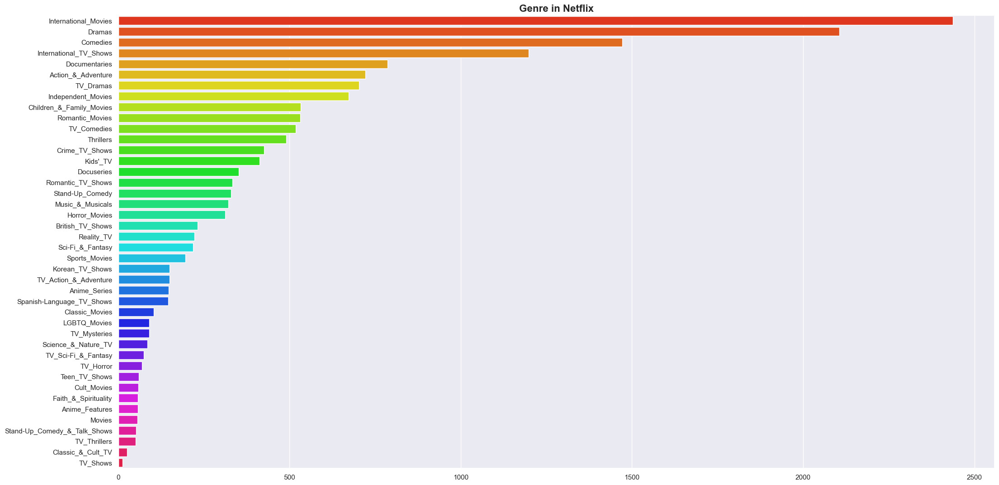

In [40]:
# Create a dictionary to count genre
genre_count_dict = count_dict_maker(df,'listed_in')

# Top Genre in movies
df_genre = pd.DataFrame.from_dict(genre_count_dict,columns=['count'], orient='index')
df_genre.sort_values('count', ascending= False, inplace=True)

# Plot the bar plot
plt.figure(figsize=(25,13))
#sns.countplot(x='rating',hue='type',data=df,palette="CMRmap")
sns.barplot(y = df_genre.index,
            x = df_genre['count'].values,palette="hsv")
plt.title("Genre in Netflix",size='16',fontweight="bold")
plt.show()

In [175]:
# top genre in countries

# Group the data by country and listed_in and get the count of titles
gb_country = exploded_df.groupby(['country','listed_in'])['title'].count()
gb_country = pd.DataFrame(gb_country)

# Sort by country and reset the index
gb_country = gb_country.sort_values('country',ascending=False).reset_index()

# Get the top 10 countries by title count
top_10_countries = gb_country.groupby('country').sum().sort_values('title', ascending=False).head(10).index.tolist()

# Filter the data to only include the top 10 countries
gb_country = gb_country[gb_country['country'].isin(top_10_countries)]

# Create the sunburst plot
fig = px.sunburst(gb_country, path=['country', 'listed_in'], values='title', color='title',
                  color_continuous_scale='YlOrRd', width=1000, height=1000)

# Update the layout to show only the top 10 countries and increase the font size
fig.update_layout(title_text='Number of Titles by Country and Listed In Category',
                  title_font_size=20,
                  title_x=0.5,
                  font=dict(size=16),
                  margin=dict(t=50, l=0, r=0, b=0),
                  sunburstcolorway=["#636efa","#EF553B","#00cc96","#ab63fa","#FFA15A","#19d3f3","#FF6692","#B6E880","#FF97FF","#FECB52"])

fig.show()


In most countries international movies is have higher count 

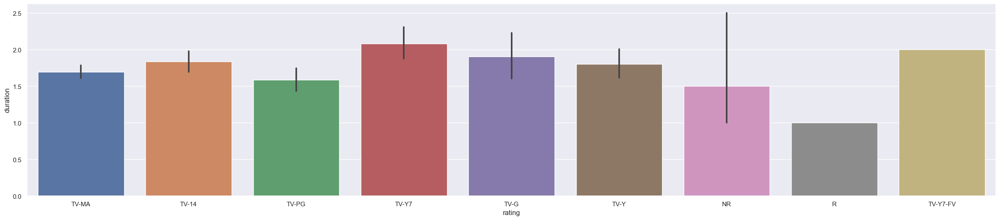

In [42]:
tv_df = df[df['type']=='TV Show']
minutes = tv_df['duration']
ratings = tv_df['rating']
plt.figure(figsize=(30,6))
ax=sns.barplot(x= ratings, y=minutes)

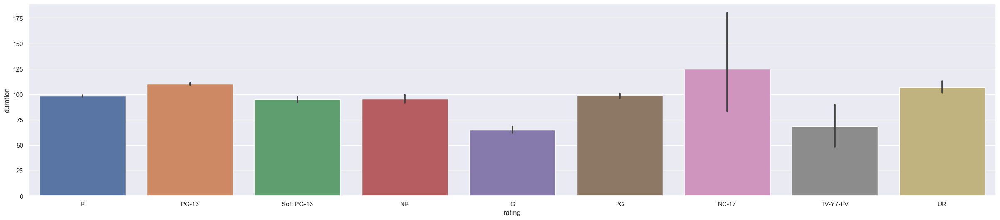

In [43]:
movies_df = df[df['type']=='Movie']
minutes = movies_df['duration']
ratings = movies_df['rating']
plt.figure(figsize=(30,6))
ax=sns.barplot(x= ratings, y=minutes)

no. of countries varies from 1 to 12
show the count in a graph

Text EDA examples
1. Examining the length of the documents:
2. Identifying common themes and topics:
3. Plotting word clouds: for different clusters

## Column - title and description

# **Clustruing**

In [44]:
df.head(2)

,index,show_id,type,title,director,cast,country,date_added,release_year,rating,...,listed_in,description,year_added,month_added,day_added,country_count,number_of_directors,number_of_casts,number_of_countries,number_of_genres
0,0,s1,TV Show,3%,[Unknown],"[JoÃ£o_Miguel, Bianca_Comparato, Michel_Gomes,...",[Brazil],2020-08-14,2020,TV-MA,...,"[International_TV_Shows, TV_Dramas, TV_Sci-Fi_...",In a future where the elite inhabit an island ...,2020,8,14,1,1,11,1,3
1,1,s2,Movie,7:19,[Jorge_Michel_Grau],"[DemiÃ¡n_Bichir, HÃ©ctor_Bonilla, Oscar_Serran...",[Mexico],2016-12-23,2016,R,...,"[Dramas, International_Movies]",After a devastating earthquake hits Mexico Cit...,2016,12,23,1,1,6,1,2


## Feature Engineering for clusting

In [45]:
# Creating new df for clustering

clust_df = df.copy()
clust_df.drop(['date_added','year_added','month_added'], axis = 1, inplace= True)
clust_df.head(2)

,index,show_id,type,title,director,cast,country,release_year,rating,duration,listed_in,description,day_added,country_count,number_of_directors,number_of_casts,number_of_countries,number_of_genres
0,0,s1,TV Show,3%,[Unknown],"[JoÃ£o_Miguel, Bianca_Comparato, Michel_Gomes,...",[Brazil],2020,TV-MA,4,"[International_TV_Shows, TV_Dramas, TV_Sci-Fi_...",In a future where the elite inhabit an island ...,14,1,1,11,1,3
1,1,s2,Movie,7:19,[Jorge_Michel_Grau],"[DemiÃ¡n_Bichir, HÃ©ctor_Bonilla, Oscar_Serran...",[Mexico],2016,R,93,"[Dramas, International_Movies]",After a devastating earthquake hits Mexico Cit...,23,1,1,6,1,2


### Encoding

In [46]:
# type col encoding
clust_df['type'] = clust_df['type'].apply(lambda x: 1 if x == 'Movie' else 0)

In [47]:
#print the  value of categorical data
cat_col = ['rating']
for col in cat_col:
    print(col,':-')
    print(df[col].value_counts())
    print('--------------------------------------------')

rating :-
R             2515
PG-13         1658
TV-MA         1018
TV-14          656
Soft PG-13     505
G              362
TV-PG          299
PG             247
TV-Y7          175
TV-Y           162
NR              83
TV-G            83
TV-Y7-FV         6
UR               5
NC-17            3
Name: rating, dtype: int64
--------------------------------------------


In [48]:
# SOURCE :- https://www.spectrum.net/support/tv/tv-and-movie-ratings-descriptions

rating_dict = {'NR':0,
                'UR':0,
                'TV-Y':1,
                'TV-Y7':2, 
                'TV-Y7-FV':3,  
                'TV-G':4,
                'G' :4,
                'TV-PG':5,
                'PG':5,
                'PG-13':6,
                'Soft PG-13':6,
                'TV-14':7,
                'R':8,
                'TV-MA':8,
                'NC-17':9}

clust_df['rating'] = clust_df['rating'].apply(lambda x: rating_dict[x] if x in rating_dict.keys() else None)
clust_df.head(1)


,index,show_id,type,title,director,cast,country,release_year,rating,duration,listed_in,description,day_added,country_count,number_of_directors,number_of_casts,number_of_countries,number_of_genres
0,0,s1,0,3%,[Unknown],"[JoÃ£o_Miguel, Bianca_Comparato, Michel_Gomes,...",[Brazil],2020,8,4,"[International_TV_Shows, TV_Dramas, TV_Sci-Fi_...",In a future where the elite inhabit an island ...,14,1,1,11,1,3


In [49]:
# Encoding countries

# Use the 'get_dummies' function to one-hot encode the data
country_df = pd.get_dummies(clust_df['country'].apply(pd.Series).stack()).sum(level=0)
country_df.drop([''], axis=1, inplace= True)
# View the resulting dataframe
country_df.head(2)

,Afghanistan,Albania,Algeria,Angola,Argentina,Armenia,Australia,Austria,Azerbaijan,Bahamas,...,Ukraine,United_Arab_Emirates,United_Kingdom,United_States,Uruguay,Vatican_City,Venezuela,Vietnam,West_Germany,Zimbabwe
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [50]:
# Encoding Casts

# Use the 'get_dummies' function to one-hot encode the data
cast_df = pd.get_dummies(clust_df['cast'].apply(pd.Series).stack()).sum(level=0)
#cast_df.drop([''], axis=1, inplace= True)
# View the resulting dataframe
cast_df.head(2)

,"""Riley""_Lakdhar_Dridi",'Najite_Dede,2_Chainz,4Minute,50_Cent,A.C._Peterson,A.D._Miles,A.J._Cook,A.J._LoCascio,A.K._Hangal,...,Åafak_Sezer,Åahin_Irmak,Åebnem_Bozoklu,Åenay_Bozoklar,Åenay_GÃ¼rler,Åerif_Sezer,Åinasi_Yurtsever,ÅÃ¼kran_OvalÄ±,ÅÃ¼krÃ¼_ÃzyÄ±ldÄ±z,á¹¢á»páº¹Ì_DÃ¬rÃ­sÃ¹
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [51]:
# Encoding directors

# Use the 'get_dummies' function to one-hot encode the data
director_df = pd.get_dummies(clust_df['director'].apply(pd.Series).stack()).sum(level=0)
#director_df.drop([''], axis=1, inplace= True)
# View the resulting dataframe
director_df.head(2)

,A.R._Murugadoss,A._L._Vijay,A._Raajdheep,A._Salaam,Aadish_Keluskar,Aamir_Bashir,Aamir_Khan,Aanand_Rai,Aaron_Burns,Aaron_Hancox,...,Ãlvaro_Longoria,Ãngel_GÃ³mez_HernÃ¡ndez,Ãagan_Irmak,Ãric_Judor,Ãric_Toledano,Ãric_Warin,Ãsold_UggadÃ³ttir,Ãskar_ThÃ³r_Axelsson,Ãmer_Faruk_Sorak,Åenol_SÃ¶nmez
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [52]:
# Encoding listed_in

# Use the 'get_dummies' function to one-hot encode the data
listed_in_df = pd.get_dummies(clust_df['listed_in'].apply(pd.Series).stack()).sum(level=0)

# View the resulting dataframe
listed_in_df.head(2)

,Action_&_Adventure,Anime_Features,Anime_Series,British_TV_Shows,Children_&_Family_Movies,Classic_&_Cult_TV,Classic_Movies,Comedies,Crime_TV_Shows,Cult_Movies,...,TV_Action_&_Adventure,TV_Comedies,TV_Dramas,TV_Horror,TV_Mysteries,TV_Sci-Fi_&_Fantasy,TV_Shows,TV_Thrillers,Teen_TV_Shows,Thrillers
0,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,1,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


add a column of indicating the movie containg top actor and dir or not

#### **Creating doc2vec model for description**

##### Text preprocessing

In [53]:
import nltk
from nltk.stem import PorterStemmer
from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet
from nltk.corpus import stopwords
from string import punctuation

def preprocess_text(text):

    #Lowercase the text
    text=text.lower()

    #Removing the punctuation
    remove_punctuation=[char for char in text if char not in punctuation]
    text=''.join(remove_punctuation)

    #Tokenizing the text
    words=nltk.word_tokenize(text)

    #Removing the stopwords
    stopwords_list=stopwords.words('english')
    without_stopwords=[word for word in words if word not in stopwords_list]

    #Stemming the words
    ps=PorterStemmer()
    stemmed_words=[ps.stem(word) for word in without_stopwords]

    #Lemmatize the Words
    wordnet_lemmatizer=WordNetLemmatizer()
    lemmatized_words=[wordnet_lemmatizer.lemmatize(word,pos="v") for word in stemmed_words]

    return lemmatized_words

In [54]:
clust_df['des_processed'] = clust_df['description']
#clust_df['des_processed'] = clust_df['description'].apply(preprocess_text)

##### Using doc2vec model for vectorization

In [55]:
# Preparing data for model

import smart_open
import gensim

def read_corpus(f, tokens_only=False):

    for i, line in enumerate(f):
        tokens = gensim.utils.simple_preprocess(line)
        if tokens_only:
            yield tokens
        else:
            # For training data, add tags
            yield gensim.models.doc2vec.TaggedDocument(tokens, [i])

train_corpus = list(read_corpus(df['description']))
test_corpus = list(read_corpus(df['description'], tokens_only=True))

In [56]:
# Training the model
model = gensim.models.doc2vec.Doc2Vec(vector_size=40, min_count=2, epochs=80)

model.build_vocab(train_corpus)

model.train(train_corpus, total_examples=model.corpus_count, epochs=model.epochs)

In [57]:
# Example
vector = model.infer_vector(['only', 'you', 'can', 'prevent', 'forest', 'fires'])
print(vector)

[ 0.14862147 -0.42363766 -0.04620874 -0.05021301 -0.26376173 -0.25280082
  0.1699334   0.35127583 -0.5015068  -0.05642625  0.17586178 -0.16072781
  0.10358331 -0.10233191  0.07816314 -0.29739365  0.6338336  -0.5156232
  0.50969374 -0.31521213 -0.13808365  0.2252911   1.0810537  -0.4627018
 -0.05762195  0.8946238  -0.88361627  0.5448175  -0.60762864  0.5400209
 -0.2647605   0.28411907  0.46641207 -0.31495437 -0.63701653 -0.15838942
  1.0948108  -0.38095883  0.3670538  -0.6457938 ]


its working !!!!

In [58]:
ranks = []
second_ranks = []
for doc_id in range(len(train_corpus)):
    inferred_vector = model.infer_vector(train_corpus[doc_id].words)
    sims = model.dv.most_similar([inferred_vector], topn=len(model.dv))
    rank = [docid for docid, sim in sims].index(doc_id)
    ranks.append(rank)

    second_ranks.append(sims[1])

Let's count how each document ranks with respect to the training corpus

NB. Results vary between runs due to random seeding and very small corpus

In [59]:
import collections

counter = collections.Counter(ranks)
print(counter)

Counter({0: 7752, 1: 21, 2: 4})


In [60]:
# Pick a random document from the test corpus and infer a vector from the model
import random 

doc_id = random.randint(0, len(test_corpus) - 1)
inferred_vector = model.infer_vector(test_corpus[doc_id])
sims = model.dv.most_similar([inferred_vector], topn=len(model.dv))

# Compare and print the most/median/least similar documents from the train corpus
print('Test Document ({}): «{}»\n'.format(doc_id, ' '.join(test_corpus[doc_id])))
print(u'SIMILAR/DISSIMILAR DOCS PER MODEL %s:\n' % model)
for label, index in [('1_MOST', 0), 
                     ('2_MOST', 1),
                     ('3_MOST', 2),
                     ('4_MOST', 3),
                     ('5_MOST', 4),
                     ('MEDIAN', len(sims)//2), ('LEAST', len(sims) - 1)]:
    print(u'%s %s: «%s»\n' % (label, sims[index], ' '.join(train_corpus[sims[index][0]].words)))

Test Document (5819): «when an astrologer gives him one year to find mate or face being alone forever professor sets out to find bride despite serious obstacles»

SIMILAR/DISSIMILAR DOCS PER MODEL Doc2Vec(dm/m,d40,n5,w5,mc2,s0.001,t3):

1_MOST (5819, 0.9481270909309387): «when an astrologer gives him one year to find mate or face being alone forever professor sets out to find bride despite serious obstacles»

2_MOST (1782, 0.6644645929336548): «in this reality series brides to be stop at nothing to have their dream weddings despite meager funds fallouts with friends or even absent grooms»

3_MOST (502, 0.6017556190490723): «nigerian couple living in the face agonizing fallout when they defy deportation orders with the hopes of giving their unborn child citizenship»

4_MOST (2530, 0.5940573811531067): «when teen siblings hayley and alex enter an elite boarding school they find rivalry romance and mystery related to the recent loss of their mom»

5_MOST (7003, 0.5882443785667419): «evide

In [61]:
df['des_vect'] = df['description'].apply(lambda x : model.infer_vector(x.split()))

# Dataframe of description vectors

des_vec_df = pd.DataFrame()
for i in range(0, len(df['des_vect'][0])):
    des_vec_df['des_vec_' + str(i)] = df['des_vect'].apply(lambda x: x[i])

des_vec_df.head()

,des_vec_0,des_vec_1,des_vec_2,des_vec_3,des_vec_4,des_vec_5,des_vec_6,des_vec_7,des_vec_8,des_vec_9,...,des_vec_30,des_vec_31,des_vec_32,des_vec_33,des_vec_34,des_vec_35,des_vec_36,des_vec_37,des_vec_38,des_vec_39
0,-0.170129,-0.032817,0.494739,-0.222504,0.912374,-0.191936,-0.237617,0.876695,-0.987795,0.428074,...,0.099248,0.603788,1.408160,-1.616455,0.213360,0.220083,1.738493,-1.470096,-0.233555,-0.487767
1,-0.056603,-0.329672,0.250516,-0.665514,0.477059,0.653259,0.322435,0.001165,0.413587,-0.151772,...,-0.264006,0.800813,0.993142,0.044055,0.203040,-1.220189,3.429141,-0.539593,0.034090,-1.096105
2,0.499169,-0.389544,0.632951,-1.444395,0.791919,0.535640,-0.665327,1.619790,-1.671054,1.405056,...,-0.556081,0.172345,-0.549550,-0.674663,-0.418266,0.309936,0.851489,-0.880982,-0.238125,-0.371403
3,-0.075779,-0.863596,0.229242,0.519961,0.060795,1.045683,0.975798,0.575086,-0.559098,-0.250667,...,0.187330,-0.678434,0.478605,-1.106632,-0.421339,0.576949,2.273268,1.268374,-0.648248,-0.116848
4,-1.362017,0.287706,-0.243203,0.263839,1.165228,-0.389450,-0.663841,1.608751,0.403663,0.241226,...,-0.171886,0.681282,0.822855,0.093796,-0.308010,0.709262,1.271833,-0.111243,-1.264278,0.090791


## Defining required function for clustering

In [63]:
# best cluster kmeans
import time
import plotly.graph_objects as go
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, calinski_harabasz_score

def find_optimal_clusters(data, max_k):
    iters = range(2, max_k+1)
    
    sse = []
    silhouette_scores = []
    ch_scores = []
    fit_times = []
    
    for k in iters:
        start_time = time.time()
        model = KMeans(n_clusters=k, init='k-means++', n_init=10, random_state=20, max_iter=300)
        model.fit(data)
        fit_times.append(time.time() - start_time)
        
        # Calculate SSE
        sse.append(model.inertia_)
        
        # Calculate silhouette score
        labels = model.predict(data)
        silhouette_scores.append(silhouette_score(data, labels))
        
        # Calculate Calinski Harabasz score
        ch_scores.append(calinski_harabasz_score(data, labels))

        #print(f'For n_clusters = {k}, Silhouette score: {silhouette_scores[-1]:.3f}, Calinski Harabasz score: {ch_scores[-1]:.3f}, Fit time: {fit_times[-1]:.3f}s')


    iters = list(range(2, max_k))

    # Create plotly figure with 3 subplots
    #fig = make_subplots(rows=3, cols=1, shared_xaxes=True, vertical_spacing=0.1, subplot_titles=('SSE', 'Silhouette Score', 'Calinski Harabasz Score'))
    fig = go.Figure()
    # Add Calinski Harabasz score trace to the third subplot
    fig.add_trace(go.Scatter(x=iters, y=ch_scores, mode='lines+markers', name='Calinski Harabasz Score'))
    
    # Add Silhouette score trace to the second subplot
    fig.add_trace(go.Scatter(x=iters, y=silhouette_scores, mode='lines+markers', name='Silhouette Score', yaxis='y2'))
    
    # Add SSE trace to the first subplot
    fig.add_trace(go.Scatter(x=iters, y=sse, mode='lines+markers', name="SSE", yaxis='y3'))
    
    # Add Calinski Harabasz score trace to the third subplot
    fig.add_trace(go.Scatter(x=iters, y=fit_times, mode='lines+markers', line=dict(dash='dash', color = 'black'), name='fitting_time', yaxis='y4'))
                        
    fig.update_layout(title = {'text':"KMeans cluster metrics",'y': 0.95,'x': 0.5,'xanchor': 'center'},
    yaxis=dict(title="Calinski harabaz score", position=0.05),
    yaxis2=dict(title="Sillhoute Score", overlaying="y", side="right"),
    yaxis3=dict(title="SSE elbow", overlaying="y", side="left", position=0.95),
    yaxis4=dict(title="Fitting Time", overlaying="y", side="left", position=0.85),
    legend=dict(x=1.1))
    
    import plotly.io as pio
    pio.write_html(fig, file='myplot.html', auto_open=False)

    fig.show()


In [64]:
# Best cluster agglomerative
import time
import plotly.graph_objects as go
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score, calinski_harabasz_score

def find_optimal_clusters_agglo(data, max_k):
    iters = range(2, max_k+1)
    
    silhouette_scores = []
    ch_scores = []
    fit_times = []
    
    for k in iters:
        start_time = time.time()
        model = AgglomerativeClustering(n_clusters=k, linkage='ward')
        model.fit(data)
        fit_times.append(time.time() - start_time)
        
        # Calculate silhouette score
        labels = model.fit_predict(data)
        silhouette_scores.append(silhouette_score(data, labels))
        
        # Calculate Calinski Harabasz score
        ch_scores.append(calinski_harabasz_score(data, labels))
        
        #print(f'For n_clusters = {k}, Silhouette score: {silhouette_scores[-1]:.3f}, Calinski Harabasz score: {ch_scores[-1]:.3f}, Fit time: {fit_times[-1]:.3f}s')

     
    iters = list(range(2, max_k))

    # Create plotly figure with 3 subplots
    fig = go.Figure()
    
    # Add Calinski Harabasz score trace to the third subplot
    fig.add_trace(go.Scatter(x=iters, y=ch_scores, mode='lines+markers', name='Calinski Harabasz Score'))

    # Add Silhouette score trace to the second subplot
    fig.add_trace(go.Scatter(x=iters, y=silhouette_scores, mode='lines+markers', name='Silhouette Score', yaxis='y2'))

    # Add Calinski Harabasz score trace to the third subplot
    fig.add_trace(go.Scatter(x=iters, y=fit_times, mode='lines+markers', line=dict(dash='dash', color = 'black'), name='fitting_time', yaxis='y3'))
                        
    fig.update_layout(title = {'text':"Agglomerative cluster metrics",'y': 0.95,'x': 0.5,'xanchor': 'center'},
    yaxis=dict(title="Calinski harabaz score", position=0.05),
    yaxis2=dict(title="Sillhoute Score", overlaying="y", side="right"),
    yaxis3=dict(title="Fitting Time", overlaying="y", side="left", position=0.95),
    legend=dict(x=1.1))
    fig.show()


In [65]:
#plots

import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.decomposition import TruncatedSVD
from scipy.sparse import csr_matrix
from sklearn.manifold import TSNE
import umap
import plotly.graph_objs as go
import plotly.subplots as sp
import pandas as pd
import numpy as np


def plot_pca_tsne_umap(df, labels_col):
    """
    Apply PCA and t-SNE on a DataFrame and plot scatter plot of the results
    :param df: DataFrame with the data
    :param labels_col: name of the labels column
    """
    labels = labels_col
    unique_labels = np.unique(labels)
    cluster_names = ['Cluster_'+str(i) for i in unique_labels]
    colors = px.colors.qualitative.Alphabet
    

    # Apply PCA to the data
    pca = PCA(n_components=3)
    pca_result = pca.fit_transform(df)
    pca_result = pd.DataFrame(pca_result)
    pca_result['labels'] = labels

    # Apply t-SNE to the data
    tsne = TSNE(n_components=3)
    tsne_result = tsne.fit_transform(df)
    tsne_result = pd.DataFrame(tsne_result)
    tsne_result['labels'] = labels

    # Apply Umap
    umap_3d = umap.UMAP(n_components=3, init='random', random_state=0)
    proj_3d = umap_3d.fit_transform(df)
    proj_3d = pd.DataFrame(proj_3d)
    proj_3d['labels'] = labels

    # Plot the results
    fig = sp.make_subplots(rows=1, cols=3, specs=[[{'type': 'scatter3d'}, {'type': 'scatter3d'}, {'type': 'scatter3d'}]])
    
    for i in unique_labels:
        color = colors[i % len(colors)]
        pca_trace = go.Scatter3d(
            x=pca_result[pca_result['labels'] == i].iloc[:, 0],
            y=pca_result[pca_result['labels'] == i].iloc[:, 1],
            z=pca_result[pca_result['labels'] == i].iloc[:, 2],
            mode='markers',
            marker=dict(size=3, symbol='circle', color=color),
            name=cluster_names[i]
        )
        fig.add_trace(pca_trace, row=1, col=1)

        tsne_trace = go.Scatter3d(
            x=tsne_result[tsne_result['labels'] == i].iloc[:, 0],
            y=tsne_result[tsne_result['labels'] == i].iloc[:, 1],
            z=tsne_result[tsne_result['labels'] == i].iloc[:, 2],
            mode='markers',
            marker=dict(size=3, symbol='circle', color=color),
            name=cluster_names[i]
        )
        fig.add_trace(tsne_trace, row=1, col=2)

        umap_trace = go.Scatter3d(
            x=proj_3d[proj_3d['labels'] == i].iloc[:, 0],
            y=proj_3d[proj_3d['labels'] == i].iloc[:, 1],
            z=proj_3d[proj_3d['labels'] == i].iloc[:, 2],
            mode='markers',
            marker=dict(size=3, symbol='circle', color=color),
            name=cluster_names[i]
        )
        fig.add_trace(umap_trace, row=1, col=3)
    
    # update layout
    fig.update_layout(
        title= {'text' :'PCA plot                                   t-SNE plot                                   UMAP plot','y': 0.95,'x': 0.5,'xanchor': 'center'}
    )
        
    fig.show()


## Group 1 : Clustering tags with one hot encoding of required column

In [66]:
from collections import Counter

In [67]:
cast_count_dict = count_dict_maker(df,'cast')
del cast_count_dict['No_cast']

threshold = [1,2,3,4]

new_dict = {}
for key, value in cast_count_dict.items():
    if value not in threshold:
        new_dict[key] = value

new_dict = dict(sorted(new_dict.items(), key=lambda item: item[1]))

cast_count_dict = new_dict

list_val = list(cast_count_dict.values())
counts_dict = Counter(list_val)
counts_dict

Counter({5: 561,
         6: 332,
         7: 225,
         8: 181,
         9: 118,
         10: 87,
         11: 53,
         12: 46,
         13: 23,
         14: 24,
         15: 15,
         16: 17,
         17: 7,
         18: 9,
         19: 3,
         20: 5,
         21: 2,
         22: 2,
         24: 3,
         25: 1,
         27: 4,
         29: 2,
         30: 2,
         35: 1,
         42: 1})

In [68]:
fam_cast_list = list(cast_count_dict.keys())
len(fam_cast_list)

1724

In [69]:
cast_count_dict = count_dict_maker(df,'director')
del cast_count_dict['Unknown']

threshold = [1,2,3,4]

new_dict = {}
for key, value in cast_count_dict.items():
    if value not in threshold:
        new_dict[key] = value

new_dict = dict(sorted(new_dict.items(), key=lambda item: item[1] , reverse=True))

cast_count_dict = new_dict

list_val = list(cast_count_dict.values())
counts_dict = Counter(list_val)
counts_dict
fam_dir_list = list(cast_count_dict.keys())

In [70]:
country_df.head(2)

,Afghanistan,Albania,Algeria,Angola,Argentina,Armenia,Australia,Austria,Azerbaijan,Bahamas,...,Ukraine,United_Arab_Emirates,United_Kingdom,United_States,Uruguay,Vatican_City,Venezuela,Vietnam,West_Germany,Zimbabwe
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [71]:
cast_df.shape

(7777, 32848)

In [72]:
test_df = cast_df.drop([col for col in cast_df if col not in fam_cast_list], axis = 1)
test_df.shape

(7777, 1724)

In [73]:
listed_in_df.head(2)

,Action_&_Adventure,Anime_Features,Anime_Series,British_TV_Shows,Children_&_Family_Movies,Classic_&_Cult_TV,Classic_Movies,Comedies,Crime_TV_Shows,Cult_Movies,...,TV_Action_&_Adventure,TV_Comedies,TV_Dramas,TV_Horror,TV_Mysteries,TV_Sci-Fi_&_Fantasy,TV_Shows,TV_Thrillers,Teen_TV_Shows,Thrillers
0,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,1,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [74]:
ohe_clust_df = pd.merge( listed_in_df, country_df, left_index=True, right_index=True, how="outer")
ohe_clust_df = pd.merge( ohe_clust_df, cast_df.drop([col for col in cast_df if col not in fam_cast_list], axis = 1), left_index=True, right_index=True)
ohe_clust_df = pd.merge( ohe_clust_df, director_df.drop([col for col in director_df if col not in fam_dir_list], axis = 1), left_index=True, right_index=True)

In [75]:
ohe_clust_df.shape

(7777, 1978)

### Kmeans

In [79]:
find_optimal_clusters(ohe_clust_df, 20)

In [76]:
kmeans_clust_ohe = KMeans(n_clusters=7, init='k-means++', random_state=20, max_iter=300)
clusters_ohe = kmeans_clust_ohe.fit_predict(ohe_clust_df)
df['cluster_ohe_tags'] = clusters_ohe

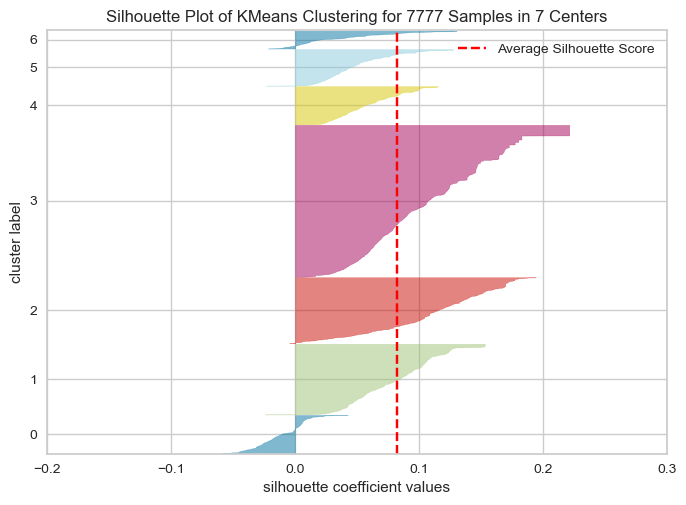

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 7777 Samples in 7 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [85]:
# Instantiate the clustering model and visualizer
from yellowbrick.cluster import SilhouetteVisualizer

#model = KMeans(n_clusters=3, init='k-means++', random_state=100, max_iter=300)
visualizer = SilhouetteVisualizer(kmeans_clust_ohe, colors='yellowbrick')

visualizer.fit(ohe_clust_df)        # Fit the data to the visualizer
visualizer.show()                  # Finalize and render the figure

### Agglomerative

In [88]:
find_optimal_clusters_agglo(ohe_clust_df,20)

In [ ]:
from scipy.cluster.hierarchy import dendrogram, linkage

# Plot the dendrogram
Z = linkage(ohe_clust_df, method='ward')
plt.figure(figsize=(12, 8))
dendrogram(Z, leaf_font_size=12)
plt.xlabel('Customer ID')
plt.ylabel('Distance')
plt.title('Dendrogram')
plt.axhline(y=30, color='r', linestyle='--')
plt.show()

In [77]:

agglo_clust_ohe = AgglomerativeClustering(n_clusters=7, affinity='euclidean', linkage='ward')
agglo_clusters_ohe = agglo_clust_ohe.fit_predict(ohe_clust_df)
df['agglo_cluster_ohe_tags'] = agglo_clusters_ohe

### Plots

In [104]:
# Kmeans
plot_pca_tsne_umap(ohe_clust_df, df['cluster_ohe_tags'])

In [105]:
# Agglromative
plot_pca_tsne_umap(ohe_clust_df, df['agglo_cluster_ohe_tags'])

## Group 2 : Clustering all data without tags and description

In [78]:
clust_scale_df = clust_df.drop(['index', 'show_id', 'title', 'director', 'cast', 'country','listed_in', 'description','des_processed','duration'], axis = 1)

In [79]:
#Normalizing the clustering data using MinMax Scaler
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
scaler.fit(clust_scale_df[['release_year']])
clust_scale_df['release_year'] = scaler.transform(clust_scale_df[['release_year']])

In [80]:
clust_scale_df.head(2)

,type,release_year,rating,day_added,country_count,number_of_directors,number_of_casts,number_of_countries,number_of_genres
0,0,0.989583,8,14,1,1,11,1,3
1,1,0.947917,8,23,1,1,6,1,2


In [62]:
sns.pairplot(clust_scale_df)

NameError: name 'clust_scale_df' is not defined

### Kmeans

In [97]:
find_optimal_clusters(clust_scale_df, 20)

In [ ]:
# Calinski Harabasz Score for K means
# Import ElbowVisualizer
from yellowbrick.cluster import KElbowVisualizer
model = KMeans(init='k-means++', random_state=20, max_iter=300)
# k is range of number of clusters.
visualizer = KElbowVisualizer(model, k=(2,20),metric='calinski_harabasz', timings= True)
visualizer.fit(clust_scale_df)        # Fit the data to the visualizer
visualizer.show()

In [81]:
kmeans_clust_scale = KMeans(n_clusters=7, init='k-means++', random_state=20, max_iter=300)
clusters_scale = kmeans_clust_scale.fit_predict(clust_scale_df)
df['cluster_scale'] = clusters_scale

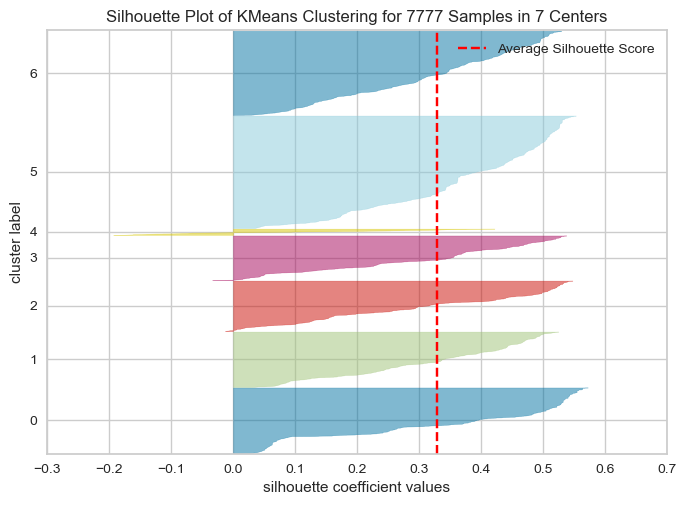

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 7777 Samples in 7 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [99]:
# Instantiate the clustering model and visualizer
from yellowbrick.cluster import SilhouetteVisualizer

#model = KMeans(n_clusters=3, init='k-means++', random_state=100, max_iter=300)
visualizer = SilhouetteVisualizer(kmeans_clust_scale, colors='yellowbrick')

visualizer.fit(clust_scale_df)     # Fit the data to the visualizer
visualizer.show()                  # Finalize and render the figure

### Agglromative 

In [101]:
find_optimal_clusters_agglo(clust_scale_df, 20)


In [ ]:
from scipy.cluster.hierarchy import dendrogram, linkage

# Plot the dendrogram
Z = linkage(clust_scale_df, method='ward')
#plt.figure(figsize=(12, 8))
dendrogram(Z, leaf_font_size=12)
plt.xlabel('Customer ID')
plt.ylabel('Distance')
plt.title('Dendrogram')
plt.axhline(y=30, color='r', linestyle='--')
plt.show()

In [108]:

agglo_clust_scale = AgglomerativeClustering(n_clusters=5, affinity='euclidean', linkage='ward')
agglo_clust_scale = agglo_clust_scale.fit_predict(clust_scale_df)
df['agglo_cluster_scale'] = agglo_clust_scale

### Plots

In [106]:
# KMeans
plot_pca_tsne_umap(clust_scale_df, df['cluster_scale'])

In [109]:
# Agglomerative
plot_pca_tsne_umap(clust_scale_df, df['agglo_cluster_scale'])

## Group 3 : Clustering of only description

### Using doc2vec

In [104]:
find_optimal_clusters(des_vec_df, 10)

In [82]:
model_kmeans_des = KMeans(n_clusters=4, init='k-means++', random_state=20, max_iter=300)
clusters_des = model_kmeans_des.fit_predict(des_vec_df)
df['cluster_des_vec'] = clusters_des

In [83]:
df['cluster_des_vec'].value_counts()

1    2152
0    1932
3    1881
2    1812
Name: cluster_des_vec, dtype: int64

In [ ]:
# Instantiate the clustering model and visualizer
from yellowbrick.cluster import SilhouetteVisualizer

#model = KMeans(n_clusters=3, init='k-means++', random_state=100, max_iter=300)
visualizer = SilhouetteVisualizer(model_kmeans_des, colors='yellowbrick')

visualizer.fit(des_vec_df)        # Fit the data to the visualizer
visualizer.show()                  # Finalize and render the figure

In [110]:
plot_pca_tsne_umap(des_vec_df, df['cluster_des_vec'])

In [85]:
find_optimal_clusters_agglo(des_vec_df, 10)

### Using LDA 

In [107]:
clust_df['des_processed'].shape

(7777,)

In [86]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score


# Convert text data into numerical representations using TF-IDF
vectorizer = TfidfVectorizer()
X = vectorizer.fit_transform(clust_df['des_processed'])

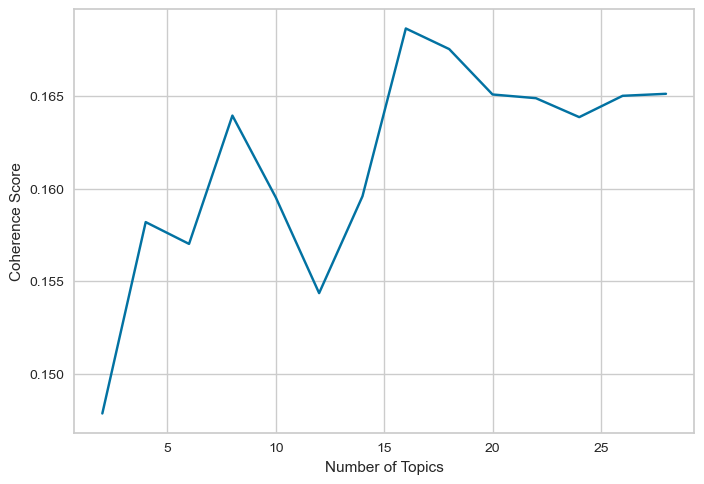

In [109]:
# Import required libraries
import gensim
from gensim.models import CoherenceModel
from gensim.utils import simple_preprocess

# Load the corpus
data= clust_df['des_processed']

def preprocess(text):
    return simple_preprocess(text)

# Apply preprocess function to the corpus
corpus = [preprocess(doc) for doc in data]

# Convert the corpus to a bag-of-words format
dictionary = gensim.corpora.Dictionary(corpus)
bow_corpus = [dictionary.doc2bow(text) for text in corpus]

# Initialize a list to store the coherence scores
coherence_scores = []

# Loop over different number of topics
for num_topics in range(2, 30, 2):
    # Train the LDA model
    lda_model = gensim.models.LdaMulticore(bow_corpus, num_topics=num_topics, id2word=dictionary)
    #lda_model = LatentDirichletAllocation(n_components=num_topics, random_state=0)

    # Compute the coherence score
    coherence_model = CoherenceModel(model=lda_model, texts=corpus, dictionary=dictionary, coherence='c_v')
    coherence_score = coherence_model.get_coherence()
    
    # Add the coherence score to the list
    coherence_scores.append(coherence_score)

# Plot the coherence scores
import matplotlib.pyplot as plt
plt.plot(range(2, 30, 2), coherence_scores)
plt.xlabel('Number of Topics')
plt.ylabel('Coherence Score')
plt.show()


In [87]:
# Train LDA model to identify the underlying topics
#lda = gensim.models.LdaMulticore(bow_corpus, num_topics=16, id2word=dictionary)
lda = LatentDirichletAllocation(n_components=16, random_state=0)
X_topics = lda.fit_transform(X)
#X_topics = lda[bow_corpus]

In [111]:
print(X_topics[330])

[0.01205188 0.01205187 0.01205186 0.01205186 0.01205186 0.01205189
 0.01205186 0.01205188 0.81922197 0.01205187 0.01205187 0.01205186
 0.01205186 0.01205186 0.01205186 0.01205188]


In [88]:
# Cluster the documents based on topic distribution
find_optimal_clusters(X_topics, 30)

In [90]:
model_kmeans_LDA = KMeans(n_clusters=16, init='k-means++', random_state=10, max_iter=500)
clusters_LDA = model_kmeans_LDA.fit_predict(X_topics)
df['cluster_LDA'] = clusters_LDA

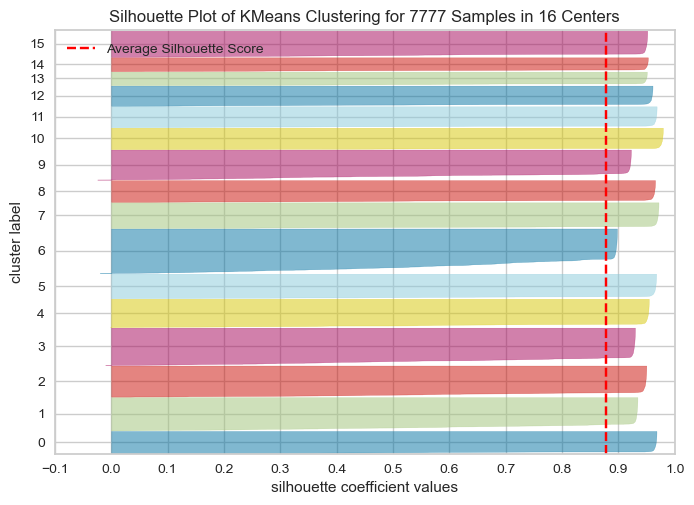

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 7777 Samples in 16 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [114]:
# Instantiate the clustering model and visualizer
from yellowbrick.cluster import SilhouetteVisualizer

#model = KMeans(n_clusters=3, init='k-means++', random_state=100, max_iter=300)
visualizer = SilhouetteVisualizer(model_kmeans_LDA, colors='yellowbrick')

visualizer.fit(X_topics)        # Fit the data to the visualizer
visualizer.show()                  # Finalize and render the figure

In [111]:
plot_pca_tsne_umap(X_topics ,clusters_LDA)

In [91]:
find_optimal_clusters_agglo(X_topics, 20)

In [92]:
agglo_model_LDA = AgglomerativeClustering(n_clusters=16, affinity='euclidean', linkage='ward')
agglo_clusters_LDA = agglo_model_LDA.fit_predict(X_topics)
df['agglo_cluster_LDA'] = agglo_clusters_LDA

In [112]:
plot_pca_tsne_umap(X_topics ,agglo_clusters_LDA)

## Clustering of all data by combining them in columns

### Merging

In [95]:
print(clust_df.shape)
print(country_df.shape)
print(listed_in_df.shape)
print(des_vec_df.shape)

(7777, 19)
(7777, 117)
(7777, 42)
(7777, 40)


In [96]:
print(clust_df.columns)
print(country_df.columns)
print(listed_in_df.columns)
print(des_vec_df.columns)

Index(['index', 'show_id', 'type', 'title', 'director', 'cast', 'country',
       'release_year', 'rating', 'duration', 'listed_in', 'description',
       'day_added', 'country_count', 'number_of_directors', 'number_of_casts',
       'number_of_countries', 'number_of_genres', 'des_processed'],
      dtype='object')
Index(['Afghanistan', 'Albania', 'Algeria', 'Angola', 'Argentina', 'Armenia',
       'Australia', 'Austria', 'Azerbaijan', 'Bahamas',
       ...
       'Ukraine', 'United_Arab_Emirates', 'United_Kingdom', 'United_States',
       'Uruguay', 'Vatican_City', 'Venezuela', 'Vietnam', 'West_Germany',
       'Zimbabwe'],
      dtype='object', length=117)
Index(['Action_&_Adventure', 'Anime_Features', 'Anime_Series',
       'British_TV_Shows', 'Children_&_Family_Movies', 'Classic_&_Cult_TV',
       'Classic_Movies', 'Comedies', 'Crime_TV_Shows', 'Cult_Movies',
       'Documentaries', 'Docuseries', 'Dramas', 'Faith_&_Spirituality',
       'Horror_Movies', 'Independent_Movies', 'Inter

In [97]:
final_clust_df = pd.merge( clust_df.drop(['index', 'show_id','title', 'director', 'cast', 'country','listed_in', 'description', 'des_processed','release_year'],axis= 1), ohe_clust_df, left_index=True, right_index=True)
final_clust_df = pd.merge( final_clust_df, des_vec_df, left_index=True, right_index=True)
final_clust_df = pd.merge( final_clust_df, listed_in_df, left_index=True, right_index=True)

In [98]:
print(final_clust_df.shape)

(7777, 2069)


In [99]:
pd.set_option('display.max_columns', None)

### k-means 

In [121]:
final_clust_df.head(2)

,type,rating,duration,day_added,country_count,number_of_directors,number_of_casts,number_of_countries,number_of_genres,Action_&_Adventure_x,Anime_Features_x,Anime_Series_x,British_TV_Shows_x,Children_&_Family_Movies_x,Classic_&_Cult_TV_x,Classic_Movies_x,Comedies_x,Crime_TV_Shows_x,Cult_Movies_x,Documentaries_x,Docuseries_x,Dramas_x,Faith_&_Spirituality_x,Horror_Movies_x,Independent_Movies_x,International_Movies_x,International_TV_Shows_x,Kids'_TV_x,Korean_TV_Shows_x,LGBTQ_Movies_x,Movies_x,Music_&_Musicals_x,Reality_TV_x,Romantic_Movies_x,Romantic_TV_Shows_x,Sci-Fi_&_Fantasy_x,Science_&_Nature_TV_x,Spanish-Language_TV_Shows_x,Sports_Movies_x,Stand-Up_Comedy_x,Stand-Up_Comedy_&_Talk_Shows_x,TV_Action_&_Adventure_x,TV_Comedies_x,TV_Dramas_x,TV_Horror_x,TV_Mysteries_x,TV_Sci-Fi_&_Fantasy_x,TV_Shows_x,TV_Thrillers_x,Teen_TV_Shows_x,Thrillers_x,Afghanistan,Albania,Algeria,Angola,Argentina,Armenia,Australia,Austria,Azerbaijan,Bahamas,Bangladesh,Belarus,Belgium,Bermuda,Botswana,Brazil,Bulgaria,Cambodia,Canada,Cayman_Islands,Chile,China,Colombia,Croatia,Cuba,Cyprus,Czech_Republic,Denmark,Dominican_Republic,East_Germany,Ecuador,Egypt,Finland,France,Georgia,Germany,Ghana,Greece,Guatemala,Hong_Kong,Hungary,Iceland,India,Indonesia,Iran,Iraq,Ireland,Israel,Italy,Jamaica,Japan,Jordan,Kazakhstan,Kenya,Kuwait,Latvia,Lebanon,Liechtenstein,Lithuania,Luxembourg,Malawi,Malaysia,Malta,Mauritius,Mexico,Mongolia,Montenegro,Morocco,Namibia,Nepal,Netherlands,New_Zealand,Nicaragua,Nigeria,Norway,Pakistan,Panama,Paraguay,Peru,Philippines,Poland,Portugal,Puerto_Rico,Qatar,Romania,Russia,Samoa,Saudi_Arabia,Senegal,Serbia,Singapore,Slovakia,Slovenia,Somalia,South_Africa,South_Korea,Soviet_Union,Spain,Sri_Lanka,Sudan,Sweden,Switzerland,Syria,Taiwan,Thailand,Turkey,Uganda,Ukraine,United_Arab_Emirates,United_Kingdom,United_States,Uruguay,Vatican_City,Venezuela,Vietnam,West_Germany,Zimbabwe,50_Cent,Aamir_Bashir,Aamir_Khan,Aaron_Eckhart,Aaron_Paul,Aasif_Mandvi,Abby_Trott,Abhay_Deol,Abhishek_Bachchan,Abigail_Breslin,Adam_Driver,Adam_Pally,Adam_Sandler,Adam_Scott,Adesua_Etomi,Adil_Hussain,Adipati_Dolken,Aditi_Rao_Hydari,Adjetey_Anang,Adrian_Pasdar,Adrian_Petriw,Adrien_Brody,AdriÃ¡n_Lastra,Ahmad_Wafiq,Ahmed_Dawood,Ahmed_Fathy,Ahmed_Fouad_Selim,Ahmed_Helmy,Ahmed_Rateb,Ai_Kayano,Ai_Nonaka,Aishwarya_Rai_Bachchan,Aislinn_Derbez,Ajay_Devgn,Akhilendra_Mishra,Aki_Toyosaki,Akio_Otsuka,Akira_Ishida,Akshay_Kumar,Akshay_Oberoi,Akshaye_Khanna,Al_Pacino,Al_Tantay,Alain_HernÃ¡ndez,Alan_C._Lim,Alan_Cumming,Alec_Baldwin,Alessandro_Juliani,Alessandro_Nivola,Alex_Abbad,Alex_Heartman,Alex_Zahara,Alexa_PenaVega,Alexander_Siddig,Alexandra_JimÃ©nez,Alfonso_Herrera,Alfre_Woodard,Alfred_Molina,Ali_Larter,Ali_Nuhu,Alia_Bhatt,Alia_Shawkat,Alice_Braga,Alice_Krige,Alicia_Vikander,Alison_Brie,Alison_Pill,Allen_Covert,Allen_Maldonado,Allison_Janney,Alok_Nath,Alvin_Wong,Alyson_Leigh_Rosenfeld,Amaia_Salamanca,Amanda_Chou,Amanda_Seyfried,Amber_Frank,Amber_Heard,America_Ferrera,America_Young,Ami_Koshimizu,Amit_Sial,Amitabh_Bachchan,Amr_Youssef,Amrish_Puri,Amrit_Pal,Amrita_Rao,Amrita_Singh,Amruta_Subhash,Amy_Adams,Amy_Poehler,Amy_Sedaris,Amy_Smart,Anamaya_Verma,Andie_MacDowell,Andrea_Frigerio,Andrea_Libman,Andrea_Riseborough,Andrew_Bachelor,Andrew_M._Gray,AndrÃ©_Holland,Andy_Garcia,Andy_Nyman,Andy_Richter,Andy_Samberg,Andy_Serkis,Angad_Bedi,Angela_Bassett,Angelica_Panganiban,Anil_Kapoor,Anita_Devgan,Anjan_Srivastav,Anjelica_Huston,Anna_Claire_Bartlam,Anna_Faris,Anna_Kendrick,Annabeth_Gish,Anne_Hathaway,Annu_Kapoor,Anson_Mount,Anthony_Anderson,Anthony_Hopkins,Anthony_LaPaglia,Anthony_Mackie,Anthony_Wong_Chau-Sang,Anton_Yelchin,Antonio_Banderas,Anupam_Kher,Anushka_Sharma,Anushka_Shetty,Aoi_Yuki,Arbaaz_Khan,Arcelia_RamÃ­rez,Ari_Ozawa,Ario_Bayu,Arjan_Bajwa,Arjun_Mathur,Arjun_Rampal,Armie_Hammer,Arshad_Warsi,Arya_Babbar,Asa_Butterfield,Ashish_Vidyarthi,Ashleigh_Ball,Ashley_Jensen,Ashley_Judd,Ashley_Tisdale,Asrani,Ata_Demirer,Atsuko_Tanaka,Atul_Kulkarni,Aubrey_Plaza,Audu_Paden,Aura_Garrido,Avan_Jogia,Av

In [122]:
# without other custer col
find_optimal_clusters(final_clust_df, 20)

In [100]:
model_kmeans_all_data = KMeans(n_clusters=6, init='k-means++', random_state=20, max_iter=300)
clusters_all_data = model_kmeans_all_data.fit_predict(final_clust_df)
df['cluster_all_data'] = clusters_all_data

In [124]:
df['cluster_all_data'].value_counts()

1    2524
5    1493
2    1434
0    1239
4     752
3     335
Name: cluster_all_data, dtype: int64

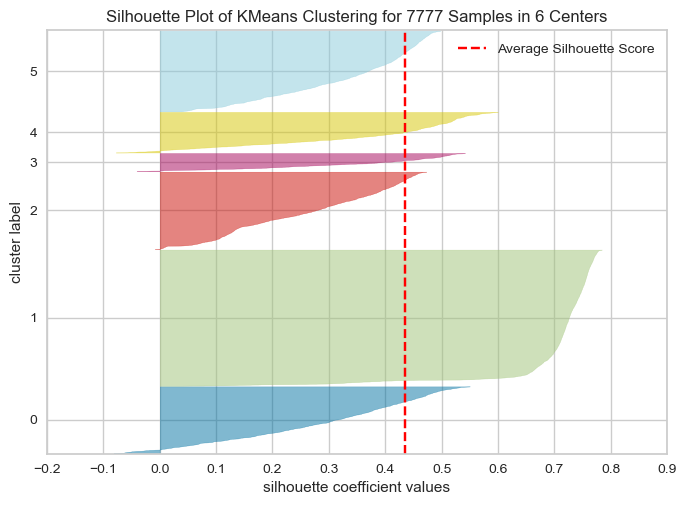

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 7777 Samples in 6 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [125]:
# Instantiate the clustering model and visualizer
from yellowbrick.cluster import SilhouetteVisualizer

#model = KMeans(n_clusters=3, init='k-means++', random_state=100, max_iter=300)
visualizer = SilhouetteVisualizer(model_kmeans_all_data, colors='yellowbrick')

visualizer.fit(final_clust_df)        # Fit the data to the visualizer
visualizer.show()                  # Finalize and render the figure

In [102]:
plot_pca_tsne_umap(final_clust_df, df['cluster_all_data'])

### Agglomative

In [128]:
find_optimal_clusters_agglo(final_clust_df,20)

In [101]:
agglo_model_kmeans_all_data = AgglomerativeClustering(n_clusters=6, affinity='euclidean', linkage='ward')
agglo_clusters_all_data = agglo_model_kmeans_all_data.fit_predict(final_clust_df)
df['agglo_cluster_all_data'] = agglo_clusters_all_data

In [103]:
plot_pca_tsne_umap(final_clust_df, df['agglo_cluster_all_data'])

# **Movie recommendation Using Cosine Simillarity and defined cluster for filtering**

## This function takes in the following arguments:

* netflix_df: a pandas dataframe containing information about the Netflix movies or shows
* model: a trained Doc2Vec model from the gensim library
* title: a string representing the title of a movie or show in the netflix_df dataframe
* cluster_column: a string representing the name of the column in netflix_df that contains the cluster  labels for each movie or show
* top_num: an integer representing the number of most similar movies or shows to return
* filter_by_cluster: a boolean flag indicating whether to only search for similar texts within the same cluster label as the input text

## The function works as follows:

* Retrieve the description of the input text based on the provided title.
* Use the trained Doc2Vec model to infer the vector representation of the input text.
* If filter_by_cluster is set to True, the function will find the cluster label of the input text and filter the netflix_df dataframe to only include texts with the same cluster label.
* The function then uses the most_similar method from the model's Docvecs object to find similar texts. If filter_by_cluster is set to True, the search for similar texts will be limited to the same cluster as the input text, otherwise the search will be across all texts in the netflix_df dataframe.
* The function returns the top_num most similar texts along with the cluster label and their descriptions, and prints a summary of the input text, its cluster label, and the most similar texts with their descriptions, similarity scores, and cluster labels.

In [129]:
import pandas as pd
from gensim.models import Doc2Vec

def find_similar_texts(netflix_df, model, title, cluster_column='cluster', top_num=10, filter_by_cluster=True):
    
    text = netflix_df[netflix_df['title'] == title]['description'].iloc[0]
    
    # Infer the vector representation of the input text
    inferred_vector = model.infer_vector(text.split())
    
    if filter_by_cluster:
        # Find the cluster label of the input text
        cluster = netflix_df[netflix_df['description'] == text][cluster_column].iloc[0]
        
        # Filter the dataframe to only include texts with the same cluster label
        filtered_df = netflix_df[netflix_df[cluster_column] == cluster]
        
        # Get the index of the input text in the filtered_df dataframe
        index = filtered_df[filtered_df['description'] == text].index[0]
        
        # limit the search of similarity to the index of the same cluster
        predefined_indices_list = filtered_df.index.tolist()
    else:
        cluster = 'No Cluster chosen'
        index = netflix_df[netflix_df['description'] == text].index[0]
        predefined_indices_list = netflix_df.index.tolist()

    # Use the most_similar method from the model's Docvecs object to find similar texts
    sims = model.docvecs.most_similar(index, topn=len(netflix_df))
    
    # limit the search of similarity to the index of the same cluster
    #predefined_indices_list = filtered_df.index.tolist()
    sims = [(i, sim) for i, sim in sims if i in predefined_indices_list]
    #sims = model.docvecs.most_similar(index, topn=len(netflix_df), filter = predefined_indices_list)
    
    # Return the most similar texts along with the cluster label
    results = [(sim, netflix_df.iloc[int(i)]['description'], netflix_df.iloc[int(i)][cluster_column],netflix_df.iloc[int(i)]['title']) for i, sim in sims]
    results[:top_num]
    print('###########################################################################################')
    print(f'Input Title       :- {title}')
    print(f'Input Description :- {text}')
    print(f'Input Cluster     :- {cluster}')
    print('###########################################################################################')
    print('')
    print(f'Recomendations :- ')
    print('------------------')
    for item in results[:top_num]:
        print(f'Similarity_score :- {item[0]}')
        print(f'Cluster          :- {item[2]}')
        print(f'Title            :- {item[3]}')
        print(f'Description      :- {item[1]}')
        print('-------------------------------------------------------------------------------------------')
    return results[:top_num]


In [130]:
df[45:48]

,index,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description,year_added,month_added,day_added,country_count,number_of_directors,number_of_casts,number_of_countries,number_of_genres,des_vect,cluster_ohe_tags,agglo_cluster_ohe_tags,cluster_scale,agglo_cluster_scale,cluster_des_vec,cluster_LDA,cluster_all_data
45,45,s46,TV Show,Åubat,[Unknown],"[Alican_YÃ¼cesoy, Melisa_SÃ¶zen, Musa_Uzunlar,...",[Turkey],2017-01-17,2013,TV-MA,1,"[Crime_TV_Shows, International_TV_Shows, TV_Dr...",An orphan subjected to tests that gave him sup...,2017,1,17,1,1,10,1,3,"[0.06106847, -0.0364528, 0.4978791, 0.92927575...",2,5,6,0,0,13,1
46,46,s47,Movie,1 Chance 2 Dance,[Adam_Deyoe],"[Lexi_Giovagnoli, Justin_Ray, Rae_Latt, Poonam...",[United_States],2017-07-01,2014,Soft PG-13,89,"[Dramas, Romantic_Movies]",When an aspiring dancer is uprooted during her...,2017,7,1,1,1,9,1,2,"[-1.4659448, -2.0395267, 0.7868968, 1.3293205,...",5,0,5,1,3,7,5
47,47,s48,Movie,1 Mile to You,[Leif_Tilden],"[Billy_Crudup, Graham_Rogers, Liana_Liberato, ...",[United_States],2017-07-07,2017,PG-13,105,"[Dramas, Romantic_Movies, Sports_Movies]",After escaping the bus accident that killed hi...,2017,7,7,1,1,8,1,3,"[-0.054627977, -1.2174139, -1.3610345, -1.0303...",5,0,5,1,0,2,5


In [132]:
sim_data = find_similar_texts(df, model, '1 Mile to You', cluster_column='cluster_LDA', top_num=10, filter_by_cluster=False)

###########################################################################################
Input Title       :- 1 Mile to You
Input Description :- After escaping the bus accident that killed his girlfriend, a high school student channels his grief into running, with the help of a new coach.
Input Cluster     :- No Cluster chosen
###########################################################################################

Recomendations :- 
------------------
Similarity_score :- 0.7344393134117126
Cluster          :- 3
Title            :- The Day of the Lord
Description      :- In this horror movie, a retired priest haunted by his sins is pulled back into the darkness when a friend begs him to help his possessed daughter.
-------------------------------------------------------------------------------------------
Similarity_score :- 0.7125639319419861
Cluster          :- 7
Title            :- Heartthrob
Description      :- A shy, brilliant boy and a popular girl fall into an unexpected r

# Conclusion

## **1- Data Overview**

**1- Data Overview**
  * We have 7787 rows and 12 columns provided in the data.

  * In the dataset we have 11 object columns and 1 integer column as release_year.

**2- Checking the null values**
  * First we have 2389 null values in director column.We have almost 30% null values in this column.so replacing null with unknown.

  * We have 718 null values in cast column. and it can be replaced with 'unknown'.

  * we have 507 null values in country column.Replacing nulls with 'mode'.

  * Also we have 10 null values in date_added column.we have few rows of date_added so we can 'drop' these rows.

  * As rating column has 0.08% null values , so replacing nulls with mose frequent TV-MA rating and doing same thing with country column

**3- Check Duplicate values in the dataset**

  * we do not have any Duplicate values in the dataset.


## **2- Feature Engineering and Data Cleaning**

**1- Handeling null values of data frame**
  * Null of Rating replaced by Mode.
  * Null of Country replaced by Mode.
  * Null of Cast replaced by No_cast.
  * Null of Director replaced by Unknown.
  * Null of Date Dropped.
  * **We left with 7777 Rows.**
  
**2- # Conversions**
  * Converting strings which are actually lists in to lists in columns (country, listed_in, cast, directior )

**3- # Adding new features**
  * We created new colums named day_added, month_added, year_added.
  * Converting duration column from string to intiger.
  * Adding new features based the list of above converted lists:- 
    1. number_of_director
    2. number_of_cast
    3. number_of_countries
    4. number_of_genres

## **2- Exploratory Data Analysis**

**'type' column**
  * According to the graph we have 5377(69.1%) movies,
  * And 2400(30.86%) as TV Show in this dataset.

**'director' column**
  * Top 3 directors are:-
    1. Jan Suter
    2. Raul Campos 
    3. Marcus Raboy

**'cast' column**
* Top 4 Casts are:-
    1. Anupam Kher      - 45 listings
    2. Shah Rukh Khan   - 35 listings
    3. Naseeruddin Shah - 30 listings
    4. Om Puri          - 30 listings

    * ADD TOP CAST COMBINATIONS ALSO

**'country' column**
* Top 3 Countries are:-
    1. United States  - 3797 listings - 39.7%
    2. India          - 990 listings - 10.4%
    3. United Kingdom - 722 listings - 7.5%

**'date_added' column:-**
  * The data shows a significant increase in the number of releases from 2015 to 2020. 
  * During this period, there were notable spikes in the number of releases in the months of October (785), November (738), December (833), and January (757), which could be due to the holiday season.
  * However, there was a sudden drop in 2021, which could be attributed to the impact of the COVID-19 pandemic.
  * Most of the content gets uploaded in the beginning and the middle of the month.


**'release_year' column**
  * We have 744 movies and	268 TV Show relese in 2017
  * Also 734 movies and	386 TV Show relese in 2018
  * Most of the content was released between 2010 and 2021

**'Rating" column**
  * As we can see the distribution is not correct, becz some movies are rated in tv rating and vice versa. so need be fixed
  * Most number of movies rated R i.e. Adult Rating
  * Most number of TV Shows rated TV-MA i.e. Adult Rating

**'duration' column**
  * TV shows - The most frequently listed duration is season 1, with 1608 listings, followed by season 2 with 378 listings.
  * Movies - The movie durations mainly range from 55 to 150 minutes, with the majority falling between 90 to 120 minutes.

**genere**
  * In Movies International_movies is the most popular genere on netflix.
  * Drama is the second most popular genere on netflix.
  * comedy is the third most popular genere on netflix.
  * Ranking is same for tv shows

**'title' column**
  * Most repeated words in title column are love, Christmas, World, Man, and life.

**'description' column**

  * Most repeated words in the description of the tv shows and movies are Family, new, Love, Life, mother, find


---



## **3- Clustering**

As the dataframe contain both type of data text and numeric, so it not good to label clusters only based on text data or numeric data, because different data type can give different clustering.

so  we applied clustering algorithm on 3 sections of data set:-

1. **Grouping 1**: 
* By applying k-means on the columns 'director', 'cast', 'country', 'listed_in', we are trying to find similar shows based on their crew and category information. This approach can be useful to discover patterns in the production crew and show categories that can be used for content recommendations or to identify production trends in the entertainment industry.

* To perform the above task Following feature Engineering has been done:-
  1. One hot encoding of 'director', 'cast', 'country', 'listed_in' columns in different dataframes 
  2. But if we merge them all together in a single dataframe, then no. of columns are very high (37,486) columns 
  3. To reduce no. of column we selected those cast, directors, which have minimum 5 listings then total downs to (1978) columns
  4. Then merged all OHE dataframe into one to apply kmeans.


* Clustering results Using Silhoutte score, Elbow graph, Calinski Harabaz score we found optimum K :- 
  1. kmeans Cluatering : k = 7
  2. Agglomerative clustering : k = 7
      
      **kMeans performed well in group 1**

2. **Grouping 2**: 
* By using k-means on the columns ['type', 'release_year', 'rating', 'country_count',
       'number_of_directors', 'number_of_casts', 'number_of_countries',
       'number_of_genres'] we are trying to find similar shows based on more quantitative data such as show type, date added, ratings, etc. This approach can be useful for creating a recommendation system that is based on these attributes.

* To perform the above task Following feature Engineering has been done:-
  1. Applied minmaxscaler on release year because it was too high no. than others 
  
* Clustering results Using Silhoutte score, Elbow graph, Calinski Harabaz score we found optimum K :- 
  1. kmeans Cluatering : k = 7
  2. Agglomerative clustering : k = 5
      
      **kMeans performed well in group 2**

3. **Grouping 3**: 
* By applying LDA (Latent Dirichlet Allocation) on the 'description' column, we are trying to extract topics or themes present in the show descriptions and then using k-means clustering to group similar shows based on these themes. This approach can be useful to understand the content and genre of shows, and to discover patterns in the storytelling, themes and genre of shows.

* We also applied kmeans on the infered vector of description column using doc2vec model, but it dosen't give good and clean clusters, thats why we used LDA.

* To perform the above task Following feature Engineering has been done:-
  1. To Use text data of description column we did some text preprocessing :-
      * lower casing
      * Remove punctuation
      * Tokenize the text
      * Removing Stop words
      * Stemming using porter stemmer 
      * lemmatization using word net lemitization
      * And join all of them in a string
  2. Then we calulated the coherence score using LDA multicore and coherence model from gensim to find the best no. of topics = 16    
  3. Then we vectorized the column using TF-IDF 
  4. Then applied LDA on the vectorized data

* Clustering results :-  Using Silhoutte score and Elbow graph we found optimum K = 16. 

3. **Grouping 4**: 
* Applying clustering to all the data used in above clusters.

* Clustering results Using Silhoutte score, Elbow graph, Calinski Harabaz score we found optimum K :- 
  1. kmeans Cluatering : k = 6
  2. Agglomerative clustering : k = 6
      
      **Kmeans performed well in group 4**

In conclusion, the different groupings of features used in k-means clustering can uncover different patterns and insights in the Netflix data frame, and the choice of features will depend on the specific use case and the questions being asked.

---



## **4- Movie recommendation Using Cosine Simillarity and defined cluster for filtering**

This function find_similar_texts takes as input a dataframe of Netflix movie descriptions and titles, a pre-trained Doc2Vec model, a title of a movie to find similar texts to, and several optional parameters such as the number of similar texts to return, the column to use for clustering, and whether or not to filter the search by cluster. The function first infers the vector representation of the input text, and then filters the dataframe to only include texts with the same cluster label if specified. It then uses the most_similar method from the model's Docvecs object to find similar texts, and returns the most similar texts along with their cluster label, similarity score, title, and description. The results are also printed in a readable format for easy visualization.